In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
from matplotlib import lines as mlines
from matplotlib import ticker
rcParams["savefig.dpi"] = 300
rcParams["figure.dpi"] = 300

In [2]:
import numpy as np
import scipy
import matplotlib as mpl
import matplotlib.pyplot as plt
import json, os, pickle, glob
import tqdm
import corner
import scipy.linalg as sl
import logging
from IPython.display import display, Math
logger = logging.getLogger(__name__)
default_colors = mpl.rcParams['axes.prop_cycle'].by_key()['color']

In [3]:
from nautilus import Sampler, Prior
from scipy.stats import uniform
from scipy.linalg import LinAlgError
import la_forge.diagnostics as dg
import la_forge.core as co
from la_forge.rednoise import gorilla_bf
from la_forge.utils import epoch_ave_resid
from h5pulsar import FilePulsar
from enterprise.signals.utils import ConditionalGP
#from la_forge.gp import Signal_Reconstruction
from enterprise_extensions.blocks import common_red_noise_block
from enterprise.signals import parameter, signal_base, utils, gp_signals, selections
from enterprise_extensions import chromatic as chrom
import enterprise.constants as const
from enterprise_extensions.empirical_distr import EmpiricalDistribution1D, EmpiricalDistribution2D
from la_forge.utils import bayes_fac
from collections import OrderedDict
DM_K = float(2.41e-4)

In [4]:
from dr3_noise import post_processing_utils as ppu
from dr3_noise import plot_utils as pu
from dr3_noise.models import model_singlepsr_noise
from targeted_cws_ng15.utils import get_prior_log_weights, weighted_quantile
from IPTA_DR2_analysis.model_blocks import adv_noise_block, lite_Tspan, full_Tspan

## Compare the GWB of lite vs lite-combined vs full

Note we will have three versions of these figures running around:
- original (unlabeled): Full unfiltered DR2 53 vs Lite filtered 21 vs EDR2 unfiltered 21
- paper version (unfiltered_21): Full unfiltered DR2 53 vs Lite unfiltered 21 vs EDR2 unfiltered 21
- presentation/appendix version (compare_filters): EDR2 filtered 21 vs Lite filtered 21 vs EDR2 unfiltered 21 vs Lite unfiltered 21

Possibly we might also use the 43 pulsar version of Lite.

Some things to make include the following:
- CRN $\gamma=13/3$:
    - Compare log-uniform Amplitude posteriors
        - Statistics: Medians + credints, BFs?
    - Compare upper limit Amplitude posteriors
        - Statistics: 95% ULs
- CRN varied $\gamma$:
    - Compare 2D posteriors
    - Statistics: Medians + credints
- CRN free spectrum:
    - Compare spectra
    - Compare single-frequency BFs

In [5]:
def make_labels(params, psrname, add_psrname=True):
    labels = []
    if add_psrname:
        add = psrname+'\n'
    else:
        add = ''
    for p in params:
        if 'dm_gp_gamma' in p:
            labels.append(add+r'$\gamma_{\rm{DM}}$')
        elif 'dm_gp_log10_A' in p:
            labels.append(add+r'$\log_{10}A_{\rm{DM}}$')
        elif 'chrom_gp_gamma' in p:
            labels.append(add+r'$\gamma_{\rm{Chr}}$')
        elif 'chrom_gp_log10_A' in p:
            labels.append(add+r'$\log_{10}A_{\rm{Chr}}$')
        elif 'chrom_gp_idx' in p:
            labels.append(add+r'$\chi_{\rm{Chr}}$')
        elif 'hf_red_noise_gamma' in p:
            labels.append(add+r'$\gamma_{\rm{HF}}$')
        elif 'hf_red_noise_log10_A' in p:
            labels.append(add+r'$\log_{10}A_{\rm{HF}}$')
        elif 'red_noise_gamma' in p:
            labels.append(add+r'$\gamma_{\rm{RN}}$')
        elif 'red_noise_log10_A' in p:
            labels.append(add+r'$\log_{10}A_{\rm{RN}}$')
        elif p == 'crn_log10_A':
            labels.append(r'$\log_{10}A_{\rm{CRN}}$')
        elif p == 'crn_gamma':
            labels.append(r'$\gamma_{\rm{CRN}}$')
        elif 'sw_gp_log10_sigma_ne' in p:
            labels.append(r'$\log_{10}\sigma_{n_E}$')
        elif 'exp1_log10_Amp' in p:
            labels.append(add+r'$\log_{10}A_{\rm{exp}}$')
        elif 'exp1_log10_tau' in p:
            labels.append(add+r'$\log_{10}\tau_{\rm{exp}}$')
        elif 'exp1_t0' in p:
            labels.append(add+r'$t_{\rm{exp}}$')
        elif 'exp1_idx' in p:
            labels.append(add+r'$\chi_{\rm{exp}}$')
        else:
            labels.append(p)
    return labels

## Compare posteriors - fixed gamma (13/3)

Combos:

    datasets = ['dr2full', 'dr2lite_unfiltered_53', 'edr2']
    labels = ['Full DR2', 'DR2 Lite', 'EDR2']
    Nfreqs = [13, 13, 13]
    save_label = ''

    datasets = ['dr2full', 'dr2lite', 'dr2litec']
    labels = ['Full DR2', 'DR2 Lite', 'EDR2']
    Nfreqs = [13, 7, 13]
    save_label = ''

    datasets = ['dr2full', 'dr2lite_unfiltered_21', 'dr2litec']
    labels = ['Full DR2', 'DR2 Lite', 'EDR2']
    Nfreqs = [13, 13, 13]
    save_label = '_unfiltered_21'
    
    datasets = ['dr2full', 'dr2lite_unfiltered_43', 'dr2litec']
    labels = ['Full DR2', 'DR2 Lite', 'EDR2']
    Nfreqs = [13, 13, 13]
    save_label = '_unfiltered_43'
    
    datasets = ['dr2litec', 'dr2lite', 'dr2lite_unfiltered_21', 'dr2litec_filtered']
    labels = ['EDR2', 'DR2 Lite filtered', 'DR2 Lite', 'EDR2 filtered']
    Nfreqs = [13, 7, 13, 7]
    save_label = '_compare_filters'

In [6]:
datasets = ['dr2full', 'dr2lite_unfiltered_53', 'edr2']
labels = ['Full DR2', 'DR2 Lite', 'EDR2']#, 'EDR2 filtered']
Nfreqs = [13, 13, 13]
save_label = ''#'_compare_filters'
noisetype = 'advnoise'
model_names = [f'CRN{Nf}_g4p3_{noisetype}' for Nf in Nfreqs]
# specify pulsar, dataset, model, and number of cores
project_path = '/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis'
# where to save figures
figsave = f'{project_path}/figs/dataset_comparisons/gwb'
load_pt_chains = False

In [7]:
# get cores
cores = {}
for ds, mn, lbl in zip(datasets, model_names, labels):
    corepath = f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/{ds}/{mn}/core.h5'
    cores[lbl] = co.Core(corepath=corepath, burn=0)

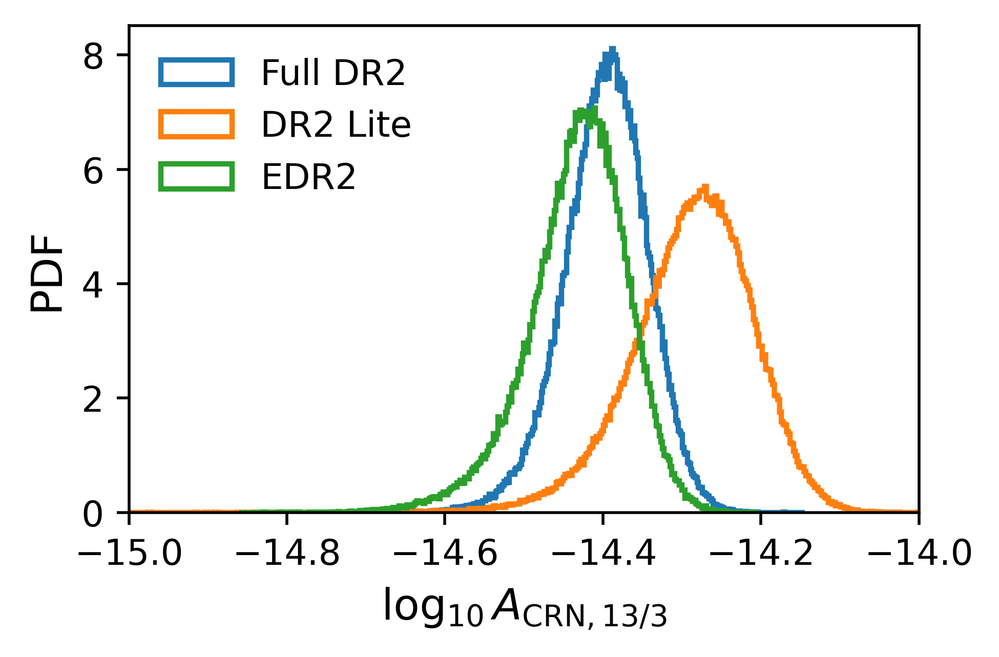

In [8]:
fig, ax = plt.subplots(figsize=(4,8/3), dpi=500)
for lbl in cores:
    ax.hist(cores[lbl]('crn_log10_A'), histtype='step', density=True, bins='auto', label=lbl, lw=1.5)
ax.set_xlabel(r'$\log_{10}A_{\rm{CRN},13/3}$', fontsize='large')
ax.set_ylabel('PDF', fontsize='large')
ax.legend(fontsize='medium', frameon=False)
ax.set_xlim([-15,-14])
#ax.set_title(r'Auto correlations only | $\gamma = 13/3$', fontsize='small')
fig.tight_layout()
fig.savefig(f'{figsave}/crn_log10_A{save_label}.png', dpi=500, bbox_inches='tight')

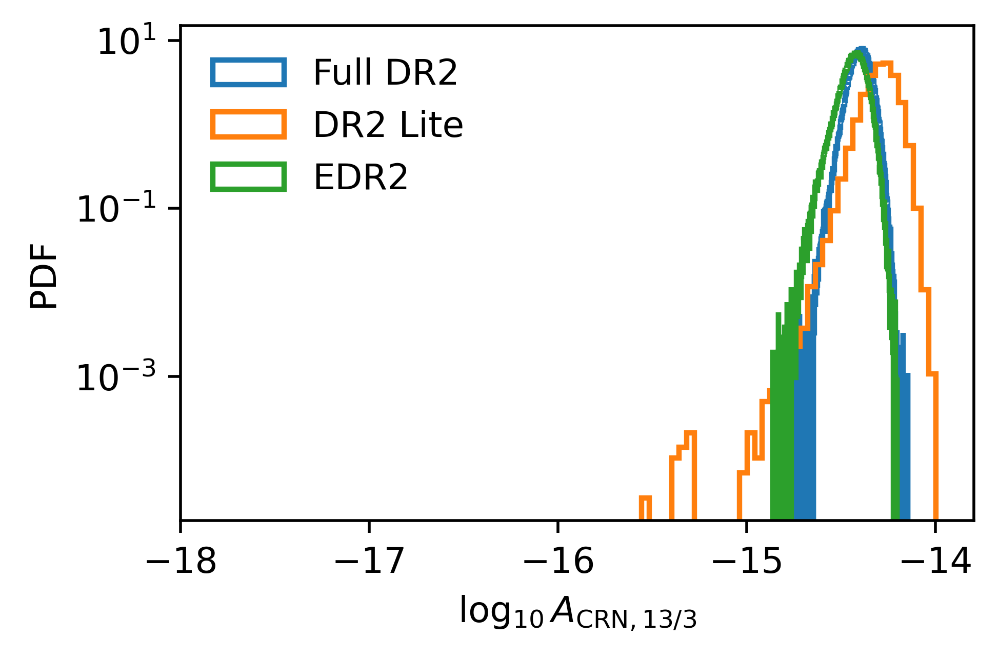

In [9]:
fig, ax = plt.subplots(figsize=(4,8/3), dpi=500)
for lbl in cores:
    if 'Lite' in lbl:
        ax.hist(cores[lbl]('crn_log10_A'), histtype='step', density=True, bins=100, label=lbl,
                range=[-18,np.max(cores[lbl]('crn_log10_A'))], lw=1.5)
    else:
        ax.hist(cores[lbl]('crn_log10_A'), histtype='step', density=True, bins='auto', label=lbl, lw=1.5)
ax.set_xlabel(r'$\log_{10}A_{\mathrm{CRN},13/3}$')
ax.set_ylabel('PDF')
ax.legend(fontsize='medium', frameon=False)
#ax.set_title(r'Auto correlations only | $\gamma = 13/3$', fontsize='small')
ax.semilogy()
xlim = ax.get_xlim()
ax.set_xlim([-18,xlim[1]])
fig.tight_layout()
fig.savefig(f'{figsave}/crn_log10_A_logy{save_label}.png', dpi=500, bbox_inches='tight')

In [15]:
# values:
for lbl in cores:
    med_A = 10**cores[lbl].get_param_median("crn_log10_A")
    A_hi = 10**cores[lbl].get_param_credint("crn_log10_A", interval=95)[1]-med_A
    A_lo = med_A-10**cores[lbl].get_param_credint("crn_log10_A", interval=95)[0]
    print(lbl)
    display(Math(fr'A_{{\rm{{CP}}}} = {med_A*1e15:.2}^{{+{A_hi*1e15:.2}}}_{{-{A_lo*1e15:.2}}}\times 10^{{-15}}'))

Full DR2


<IPython.core.display.Math object>

DR2 Lite


<IPython.core.display.Math object>

EDR2


<IPython.core.display.Math object>

In [16]:
# Upper limits
lnw = {}
for lbl in cores:
    lnw[lbl] = get_prior_log_weights(cores[lbl]('crn_log10_A'), prior1_args=[-18,-12], prior0_args=[-18,-12])

Full DR2


<IPython.core.display.Math object>

DR2 Lite


<IPython.core.display.Math object>

EDR2


<IPython.core.display.Math object>

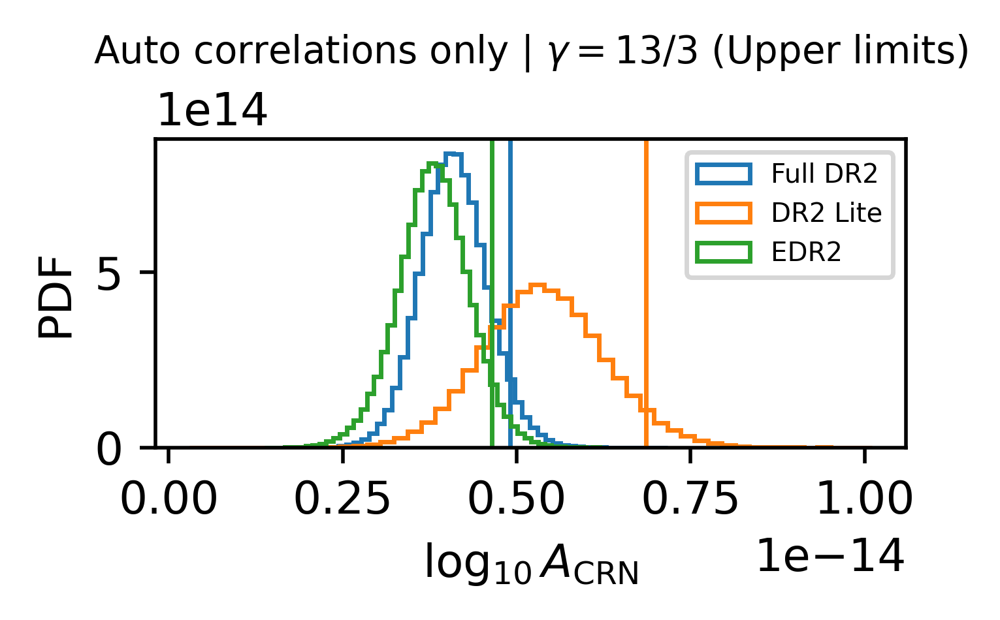

In [17]:
fig, ax = plt.subplots(figsize=(3,2), dpi=500)
for i, lbl in enumerate(cores):
    A_UL = 10**weighted_quantile(cores[lbl]("crn_log10_A"), 0.95, sample_weight=np.exp(lnw[lbl]))
    print(lbl)
    display(Math(fr'A_{{\rm{{CRN}}}}^{{95\%}} = {A_UL*1e15:1.2} \times 10^{{-15}}'))
    ax.hist(10**cores[lbl]('crn_log10_A'), weights=np.exp(lnw[lbl]),
            histtype='step', density=True, bins=50, label=lbl, color=f'C{i}')
    ax.axvline(A_UL, color=f'C{i}', lw=1)
ax.set_xlabel(r'$\log_{10}A_{\rm{CRN}}$')
ax.set_ylabel('PDF')
ax.legend(fontsize='xx-small')
ax.set_title(r'Auto correlations only | $\gamma = 13/3$ (Upper limits)', fontsize='small')
fig.tight_layout()
#fig.savefig(f'{figsave}/crn_A_UL.png', dpi=500, bbox_inches='tight')

#### Bayes factor - lite only

Need the FL to get other models BFs

In [44]:
from la_forge.utils import bayes_fac
from la_forge.rednoise import gorilla_bf

In [32]:
core = cores['DR2 Lite']
BF = bayes_fac(core('crn_log10_A'), ntol=50, smallest_dA=0.1, largest_dA=1)
display(Math(fr'\mathcal{{B}}^{{\rm{{CP}}}} = {BF[0]:1.2f} \pm {BF[1]:1.2f}'))

<IPython.core.display.Math object>

In [34]:
gorilla_bf(core('crn_log10_A'), min=-18, max=-12)

898.6244239631336

## Compare posteriors - varied $\gamma$

In [9]:
model_names = [f'CRN{Nf}_{noisetype}' for Nf in Nfreqs]
# specify pulsar, dataset, model, and number of cores
project_path = '/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis'
# where to save figures
figsave = f'{project_path}/figs/dataset_comparisons/gwb'
load_pt_chains = False

In [10]:
# get cores
cores = {}
for ds, mn, lbl in zip(datasets, model_names, labels):
    corepath = f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/{ds}/{mn}/core.h5'
    cores[lbl] = co.Core(corepath=corepath)

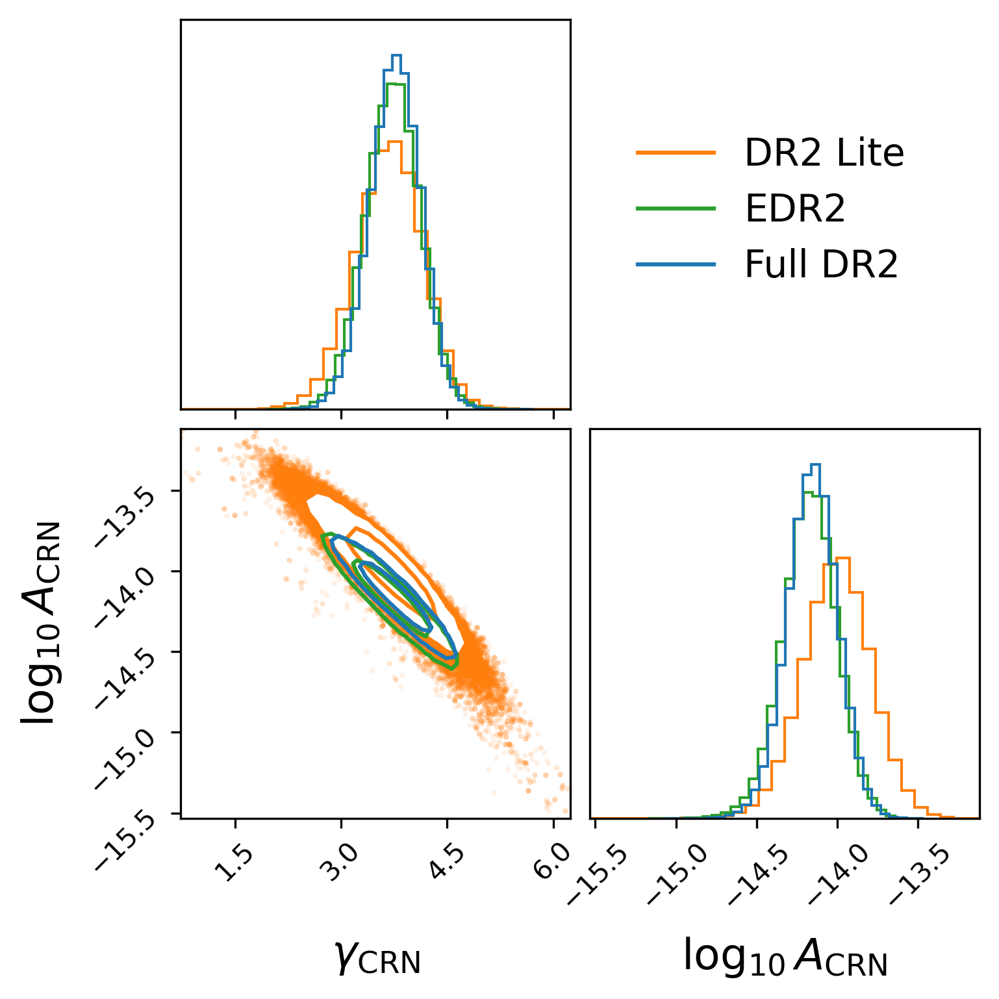

In [11]:
leg_size = 14 # 10
order = [1,2,0]#[1,3,2,0]#[1,2,0]
params = [p for p in cores[labels[order[-1]]].params if 'crn' in p]
param_labels = make_labels(params, None, add_psrname=False)
alphas = [[0,0.3,0.6],[0,0.15,0.3],[0,0.3,0.6]]
lines = []
for i in order:
    lbl = labels[i]
    p_idxs = [cores[lbl].params.index(p) for p in params]
    if i == order[0]:
        fig = corner.corner(cores[lbl].chain[:,p_idxs], levels=(0.68,0.95), labels=param_labels,
                            color=f'C{i}', plot_density=False, plot_datapoints=True,
                            no_fill_contours=False, hist_kwargs={'density':True},
                            label_kwargs={'fontsize':16}, bins=30, #smooth=0.5,
                            hist2d_kwargs={'contour_kwargs':{'zorder':2,'lw':0.1}})#,
                            #contourf_kwargs={'colors': [(*mpl.colors.to_rgb(default_colors[i]), alphas[i][0]),
                            #                            (*mpl.colors.to_rgb(default_colors[i]), alphas[i][1]),
                            #                            (*mpl.colors.to_rgb(default_colors[i]), alphas[i][2])]})
    else:
        fig = corner.corner(cores[lbl].chain[:,p_idxs], levels=(0.68,0.95), fig=fig,
                            color=f'C{i}', plot_density=False, plot_datapoints=False,
                            no_fill_contours=True, hist_kwargs={'density':True},
                            bins=30, #smooth=0.5, 
                            hist2d_kwargs={'contour_kwargs':{'zorder':1,'lw':0.1}})#,
                            #contourf_kwargs={'colors': [(*mpl.colors.to_rgb(default_colors[i]), alphas[i][0]),
                            #                            (*mpl.colors.to_rgb(default_colors[i]), alphas[i][1]),
                            #                            (*mpl.colors.to_rgb(default_colors[i]), alphas[i][2])]})
    lines += [mlines.Line2D([],[],color=f'C{i}',label=lbl)]
# add 13/3 line
axes = np.array(fig.axes).reshape((2,2))
#axes[0,0].set_xlim(np.quantile(cores['DR2 Lite']('crn_gamma'), [0.003,0.997]))
#axes[1,0].set_xlim(np.quantile(cores['DR2 Lite']('crn_gamma'), [0.003,0.997]))
#axes[1,0].set_ylim(np.quantile(cores['DR2 Lite']('crn_log10_A'), [0.003,0.999]))
#axes[1,1].set_xlim(np.quantile(cores['DR2 Lite']('crn_log10_A'), [0.003,0.999]))
#axes[0,0].axvline(13/3, color='k', lw=1)
#axes[1,0].axvline(13/3, color='k', lw=1)
#axes[1,0].axhline(np.log10(2.8e-15), color='k', lw=1)
#axes[1,1].axvline(np.log10(2.8e-15), color='k', lw=1)
#lines += [mlines.Line2D([],[],color='k',lw=1,label=f'Antoniadis+2022\n'+r'$\gamma_{{\rm{{CRN}}}}=13/3$ values')]
fig.legend(handles=lines, fontsize=leg_size, frameon=False, loc='upper right', bbox_to_anchor=[0.89,0.85])
#fig.suptitle('Auto correlations only', x=0.75, y=0.59, fontsize=14) # x=0.37, y=0.97
fig.savefig(f'{figsave}/crn_corner{save_label}.png', dpi=300, bbox_inches='tight')
plt.show()

In [107]:
# values:
for lbl in cores:
    med_A = 10**cores[lbl].get_param_median("crn_log10_A")*1e15
    A_hi = 10**cores[lbl].get_param_credint("crn_log10_A", interval=95)[1]*1e15-med_A
    A_lo = med_A-10**cores[lbl].get_param_credint("crn_log10_A", interval=95)[0]*1e15
    med_gam = cores[lbl].get_param_median("crn_gamma")
    gam_hi = cores[lbl].get_param_credint("crn_gamma", interval=95)[1]-med_gam
    gam_lo = med_gam-cores[lbl].get_param_credint("crn_gamma", interval=95)[0]
    print(lbl)
    display(Math(fr'A_{{\rm{{CP}}}} = {med_A:2.1f}^{{+{A_hi:2.1f}}}_{{-{A_lo:2.1f}}}\times 10^{{-15}}'))
    display(Math(fr'\gamma_{{\rm{{CP}}}} = {med_gam:.1f}^{{+{gam_hi:.1f}}}_{{-{gam_lo:.1f}}}'))

Full DR2


<IPython.core.display.Math object>

<IPython.core.display.Math object>

DR2 Lite


<IPython.core.display.Math object>

<IPython.core.display.Math object>

EDR2


<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [108]:
def get_contour(core, levels=[0.95], bins_2d=30, weights=None, ax=None):
    x = core('crn_gamma')
    y = core('crn_log10_A')

    H, X, Y = np.histogram2d(
        x.flatten(),
        y.flatten(),
        bins=bins_2d,
        weights=weights,
    )

    # Compute the density levels.
    Hflat = H.flatten()
    inds = np.argsort(Hflat)[::-1]
    Hflat = Hflat[inds]
    sm = np.cumsum(Hflat)
    sm /= sm[-1]
    V = np.empty(len(levels))
    for i, v0 in enumerate(levels):
        try:
            V[i] = Hflat[sm <= v0][-1]
        except IndexError:
            V[i] = Hflat[0]
    V.sort()
    m = np.diff(V) == 0
    if np.any(m) and not quiet:
        logging.warning("Too few points to create valid contours")
    while np.any(m):
        V[np.where(m)[0][0]] *= 1.0 - 1e-4
        m = np.diff(V) == 0
    V.sort()

    # Compute the bin centers.
    X1, Y1 = 0.5 * (X[1:] + X[:-1]), 0.5 * (Y[1:] + Y[:-1])

    # Extend the array for the sake of the contours at the plot edges.
    H2 = H.min() + np.zeros((H.shape[0] + 4, H.shape[1] + 4))
    H2[2:-2, 2:-2] = H
    H2[2:-2, 1] = H[:, 0]
    H2[2:-2, -2] = H[:, -1]
    H2[1, 2:-2] = H[0]
    H2[-2, 2:-2] = H[-1]
    H2[1, 1] = H[0, 0]
    H2[1, -2] = H[0, -1]
    H2[-2, 1] = H[-1, 0]
    H2[-2, -2] = H[-1, -1]
    X2 = np.concatenate(
        [
            X1[0] + np.array([-2, -1]) * np.diff(X1[:2]),
            X1,
            X1[-1] + np.array([1, 2]) * np.diff(X1[-2:]),
        ]
    )
    Y2 = np.concatenate(
        [
            Y1[0] + np.array([-2, -1]) * np.diff(Y1[:2]),
            Y1,
            Y1[-1] + np.array([1, 2]) * np.diff(Y1[-2:]),
        ]
    )

    # Let's get the area of each contour
    cs = ax.contour(X2, Y2, H2.T, V)
    return cs.collections[0]

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

{'Full DR2': 0.385955151890415,
 'DR2 Lite': 0.7557924286709489,
 'EDR2': 0.46740099032759147}

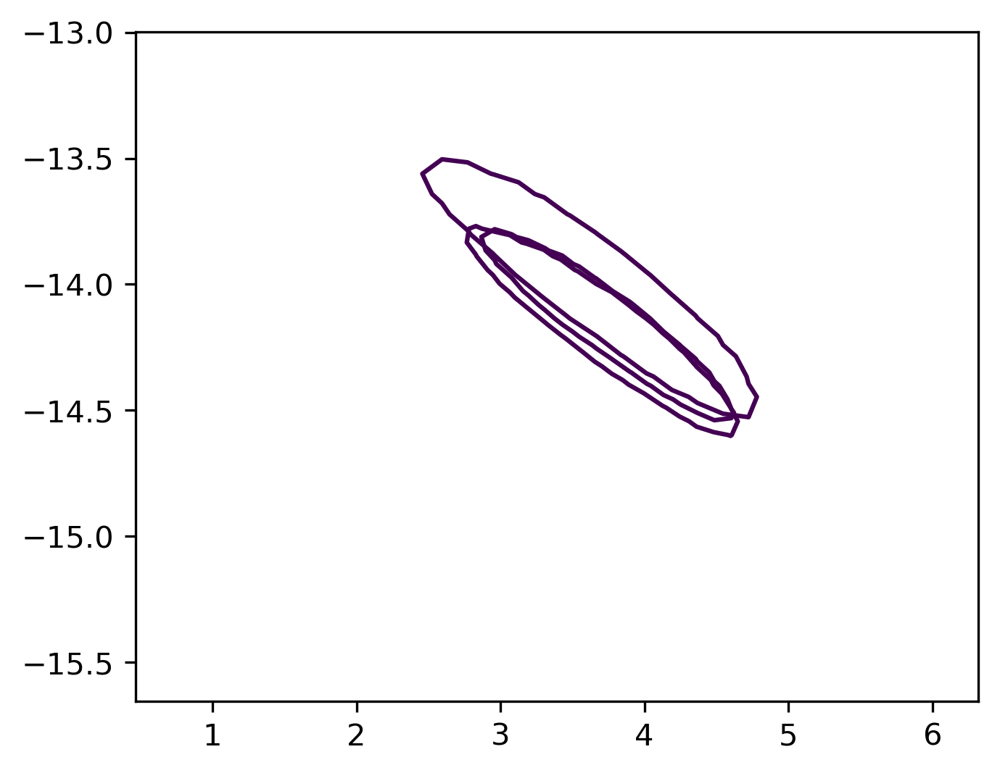

In [109]:
fig, ax = plt.subplots(figsize=(5,4))
area = {}
for lbl in labels:
    contour = get_contour(cores[lbl], ax=ax)
    x=contour.get_paths()[0].vertices[:,0]
    y=contour.get_paths()[0].vertices[:,1]
    A=0.5*np.sum(y[:-1]*np.diff(x) - x[:-1]*np.diff(y))
    area[lbl]=np.abs(A)
display(Math(fr'$A_{{\mathrm{{Lite}}}}/A_{{\mathrm{{EDR2}}}} = {area["DR2 Lite"]/area["EDR2"]:0.2f}$'))
display(Math(fr'$A_{{\mathrm{{EDR2}}}}/A_{{\mathrm{{Full}}}} = {area["EDR2"]/area["Full DR2"]:0.2f}$'))
display(Math(fr'$A_{{\mathrm{{Lite}}}}/A_{{\mathrm{{Full}}}} = {area["DR2 Lite"]/area["Full DR2"]:0.2f}$'))
area

## Compare free spectra

In [23]:
from DR3_noise_modeling.custom_plotting import plot_rednoise_spectrum
from la_forge.utils import compute_rho

In [24]:
model_names = [f'CRN{Nf}_FS_{noisetype}' for Nf in Nfreqs]
# specify pulsar, dataset, model, and number of cores
project_path = '/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis'
# where to save figures
figsave = f'{project_path}/figs/dataset_comparisons/gwb'
load_pt_chains = False

In [25]:
# get cores
cores = {}
cores_pl = {}
for ds, mn, lbl in zip(datasets, model_names, labels):
    try:
        corepath = f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/{ds}/{mn}/core.h5'
        cores[lbl] = co.Core(corepath=corepath)
        cores_pl[lbl] = co.Core(corepath=corepath.replace('_FS',''))
    except:
        pass

In [26]:
cores

{'Full DR2': <la_forge.core.Core at 0x15159fc53e20>,
 'DR2 Lite': <la_forge.core.Core at 0x151594338670>,
 'EDR2': <la_forge.core.Core at 0x15159433be80>}

In [27]:
# set freqs
i = 0
for lbl in cores:
    #if lbl == 'DR2 lite':
    #    Tspan = lite_Tspan
    #else:
    Tspan = full_Tspan
    freqs = np.linspace(1/Tspan, Nfreqs[i]/Tspan, Nfreqs[i])
    cores[lbl].rn_freqs = freqs
    i += 1

In [45]:
def fs_bayesfac(c, signal_name, Nfreqs):
    bf = np.zeros(Nfreqs)
    bf_sig = np.zeros(Nfreqs)
    for i in range(Nfreqs):
        p = f'{signal_name}_log10_rho_{i}'
        bf[i], bf_sig[i] = bayes_fac(c.get_param(p, to_burn=True),
                                     logAmin=-10, logAmax=-4, ntol=50)
    return bf, bf_sig

In [29]:
cores[lbl].rn_freqs

array([1.04959726e-09, 2.09919453e-09, 3.14879179e-09, 4.19838906e-09,
       5.24798632e-09, 6.29758359e-09, 7.34718085e-09, 8.39677811e-09,
       9.44637538e-09, 1.04959726e-08, 1.15455699e-08, 1.25951672e-08,
       1.36447644e-08])

In [30]:
1/cores[lbl].rn_freqs/const.yr

array([30.19071113, 15.09535557, 10.06357038,  7.54767778,  6.03814223,
        5.03178519,  4.31295873,  3.77383889,  3.35452346,  3.01907111,
        2.7446101 ,  2.51589259,  2.32236239])

In [31]:
# get pulsars
psrs = []
psr_paths = np.sort(glob.glob(f'{project_path}/data/full_ePSRs/J*'))
for psr_path in psr_paths:
    with open(psr_path,'rb') as f:
        psrs.append(FilePulsar(f))

In [32]:
cores['DR2 Lite']('crn_log10_rho_0')

array([-5.40184824, -5.40184824, -5.37471461, ..., -5.31621395,
       -5.31621395, -5.17547902])

In [34]:
hist,_ = np.histogram(cores['DR2 Lite']('crn_log10_rho_3'), bins=50, density=True)
np.max(hist)

2.812623602443533

In [39]:
core = cores['DR2 Lite']
start_idx = core.params.index('crn_log10_rho' + '_0')
end_idx = core.params.index('crn_log10_rho' + '_' + str(len(freqs)-1))+1
widths=0.8e-9/2.8
widths = np.ones(len(freqs))*widths
for i, idx in enumerate(range(start_idx,end_idx)):
    widths[i] *= np.max(np.histogram(core.chain[core.burn:, idx], bins=50, density=True)[0])
widths

array([5.55530895e-10, 1.78340314e-10, 1.38701911e-10, 8.03606744e-10,
       1.39535358e-10, 1.68158289e-10, 3.39646578e-10, 1.31741008e-10,
       1.34125766e-10, 1.75202482e-10, 1.13026670e-10, 1.52150258e-10,
       1.96266008e-10])

[ 0.90224815  1.80449629  3.60899258  7.21798516 14.43597033]


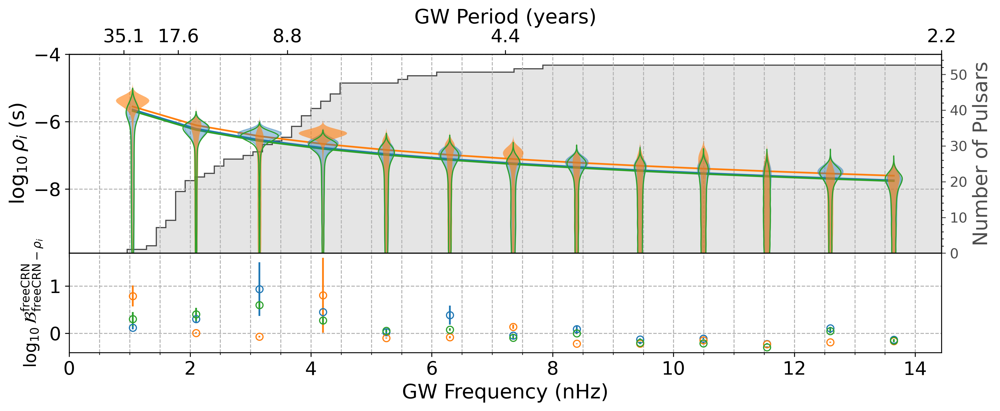

In [46]:
# make fig
fig, axes = plt.subplots(2,1,figsize=(12,5),sharex=True,
                         gridspec_kw={'height_ratios': [3, 1.5]})

print('plot violins')
ax, fig = plot_rednoise_spectrum('', list(cores.values()), return_plot=True, plot_fyr=False,
                                 free_spec_violin=True, show_figure=False,
                                 plot_2d_hist=False, verbose=False, labels=labels,
                                 semilogx=False, fig=fig, Colors=['C0','C1','C2'],
                                 set_title=False, axes=list(axes),
                                 legend=False, rasterized=True, violin_widths=0.8e-9/2.8,
                                 normalize=True)#,
                                 #Fillstyle='partial')
axes[0].set_ylim([-9.9,-4])

# plot MAP power law result
print('plot powerlaw')
for i, lbl in enumerate(cores_pl):
    if lbl == 'DR2 lite':
        Tspan = lite_Tspan
    else:
        Tspan = full_Tspan
    log10_A = cores_pl[lbl].median('crn_log10_A')
    gamma = cores_pl[lbl].median('crn_gamma')
    rho = compute_rho(log10_A, gamma, cores[lbl].rn_freqs, Tspan)
    axes[0].plot(cores[lbl].rn_freqs, np.log10(rho), color=f'C{i}', lw=1.5, ls='-',
                 zorder=6, rasterized=True)

# get BFs
print('get Bayesfacs')
for i, lbl in enumerate(cores):
    bfs, bf_sigs = fs_bayesfac(cores[lbl], 'crn', len(cores[lbl].rn_freqs))
    masks = np.logical_or(np.isnan(bf_sigs),np.isnan(bfs))
    ylim = np.diff(axes[1].get_ylim())
    # BF lower limits
    max_ = 50
    # fix nans in BF estimates
    for idx in range(len(masks)):
        if masks[idx]:
            bfs[idx] = np.nanmin([max_, bfs[idx]])

    # plot
    axes[1].errorbar(cores[lbl].rn_freqs[~masks],
                     np.log10(bfs[~masks]),
                     yerr=bf_sigs[~masks], fmt='o',
                     color=f'C{i}', mfc='none', rasterized=True)
    axes[1].errorbar(cores[lbl].rn_freqs[masks],
                     np.log10(bfs[masks]),
                     yerr=ylim[0]/10, lolims=True, fmt='o',
                     color=f'C{i}', mfc='none', rasterized=True)
ylim = axes[1].get_ylim()
axes[1].grid(which='both', linestyle='--')
axes[0].set_ylabel(r'$\log_{10}\rho_i$ (s)', fontsize='xx-large')
axes[1].set_ylabel(r'$\log_{10}\mathcal{B}^{\mathrm{freeCRN}}_{\mathrm{freeCRN} - \rho_i}$', fontsize='x-large')
axes[1].set_xlabel('GW Frequency (nHz)', fontsize='xx-large')

axes[0].tick_params(axis='both', which='major', labelsize=16)
axes[1].tick_params(axis='both', which='major', labelsize=16)
axes[1].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x,pos: f'{1e9*x:1.0f}'))
xlim = axes[1].get_xlim()
axes[1].set_xlim([0,xlim[1]])

freqs2 = np.array([xlim[1]/16, xlim[1]/8, xlim[1]/4, xlim[1]/2, xlim[1]])
Times = [np.round(val,decimals=1) for val in 1/freqs2/const.yr]

ax2 = axes[0].twiny()
ax2.set_xticks(1e9*freqs2)
print(ax2.get_xticks())
ax2.set_xticklabels(Times)
ax2.tick_params(axis='both', which='major', labelsize=16)
ax2.set_xlabel('GW Period (years)', fontsize='xx-large')

# overplot histogram
Tspans = np.array([(psr.toas.max() - psr.toas.min())/const.yr for psr in psrs])
lowfs = 1/Tspans/const.yr
axes[0].hist(lowfs, bins=100, cumulative=True, range=(0,16e-9), histtype='step',
             color='0.3', zorder=0, weights=np.ones(len(lowfs))*(6/56), bottom=-10)
axes[0].hist(lowfs, bins=100, cumulative=True, range=(0,16e-9), histtype='stepfilled',
             color='k', alpha=0.1, zorder=0, weights=np.ones(len(lowfs))*(6/56), bottom=-10)
axes[0].set_xlim([0,xlim[1]])
# add the secondary plot labels, using a transparent plot trick to automatically get the axes right
ax3 = axes[0].twinx()
ax3.hist(lowfs, bins=100, cumulative=True, range=(0,16e-9), histtype='stepfilled', color='k', alpha=0)
ax3.tick_params(axis='y', colors='0.3', which='major', labelsize=12)
ax3.minorticks_on()
ax3.set_ylabel('Number of Pulsars', color='0.3', fontsize='xx-large')
ax3.set_xlim([0,xlim[1]])

fig.tight_layout()
fig.subplots_adjust(hspace=0)
fig.savefig(f'{figsave}/FS{save_label}.png', dpi=600, bbox_inches='tight')
plt.show()

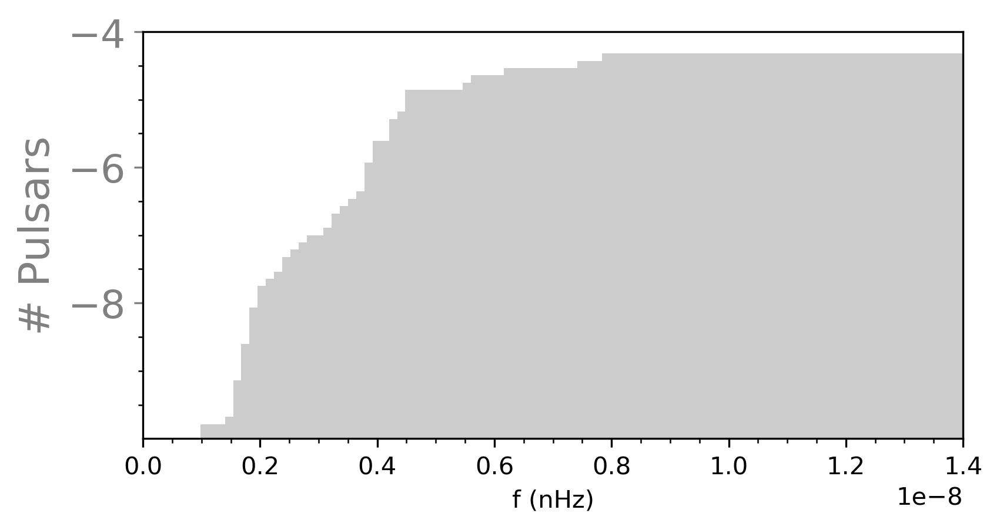

In [201]:
#plt.rcdefaults()
fig, ax = plt.subplots(figsize=(6,3))
ax.hist(lowfs, bins=100, cumulative=True, range=(0,14e-9),
        histtype='stepfilled', color='k', alpha=0.2, zorder=1, bottom=-10,
        weights=np.ones(len(lowfs))*(6/56))
ax.set_xlabel('f (nHz)')
ax.tick_params(axis='y', colors='0.5', which='major', labelsize=16)
ax.set_ylabel('# Pulsars', color='0.5', fontsize='xx-large')
ax.set_xlim([0,14e-9])
ax.minorticks_on()
ax.set_ylim([-9.999,-4])

#ax2 = ax.twinx()
#ax2.plot([1e-8,1e-8],[20,30],'ok', zorder=0)

#ax.grid(which='both', axis='y',lw=0.3)
#fig.savefig(f'{figsave}/Tspans.png', dpi=300, bbox_inches='tight')
plt.show()

In [152]:
xlim[1]/8

1.7843153494373239e-09

In [ ]:
Times = [30,15,7.5,3.25]

In [141]:
cores[lbl].rn_freqs

array([1.04959726e-09, 2.09919453e-09, 3.14879179e-09, 4.19838906e-09,
       5.24798632e-09, 6.29758359e-09, 7.34718085e-09, 8.39677811e-09,
       9.44637538e-09, 1.04959726e-08, 1.15455699e-08, 1.25951672e-08,
       1.36447644e-08])

In [137]:
print(axes[0].get_xticks())

[0.0e+00 2.0e-09 4.0e-09 6.0e-09 8.0e-09 1.0e-08 1.2e-08 1.4e-08 1.6e-08]


In [136]:
print(ax2.get_xticks())

[1.04959726e-09 2.09919453e-09 3.14879179e-09 4.19838906e-09
 5.24798632e-09 6.29758359e-09 7.34718085e-09 8.39677811e-09
 9.44637538e-09 1.04959726e-08 1.15455699e-08 1.25951672e-08
 1.36447644e-08]


In [132]:
len(['']+list(1/cores[lbl].rn_freqs/const.yr))

14

## Compare posteriors using the FL

In [12]:
datasets = ['dr2full', 'dr2lite_unfiltered_53', 'edr2']
labels = ['Full DR2', 'DR2 Lite', 'EDR2']
Nfreqs = [13]*3
Tspans = [full_Tspan]*3
noisetype = 'advnoise'
model_names = [f'CRN{Nf}_g4p3_{noisetype}' for Nf in Nfreqs]
outdirs = [f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/dr2full/factlike',
           f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/dr2lite_unfiltered/CRN13_FL/',
           f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/dr2full/factlike']
noisepaths=[f'{project_path}/noisedicts/dr2full_advnoise.json',
            f'{project_path}/noisedicts/dr2lite_unfiltered_advnoise.json',
            f'{project_path}/noisedicts/dr2full_advnoise.json',]

In [13]:
# get cores
cores = {}
for ds, mn, lbl in zip(datasets, model_names, labels):
    corepath = f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/{ds}/{mn}/core.h5'
    cores[lbl] = co.Core(corepath=corepath, burn=0)

In [14]:
for i in range(3):
    if not os.path.isdir(f'{project_path}/data/{datasets[i]}_ePSRs'):
        psr_paths = glob.glob(f'{project_path}/data/{datasets[i][3:]}_ePSRs/*')
    else:
        psr_paths = glob.glob(f'{project_path}/data/{datasets[i]}_ePSRs/*')
    print(len(psr_paths))
    break

53


In [44]:
#idx_test = 1
#all_psrnames = np.sort(np.unique([p.split('/')[-1].split('_')[0] for p in glob.glob(f'{outdirs[idx_test]}/*')]))
#psrnames = np.sort([p.split('/')[-1].split('_')[0] for p in glob.glob(f'{outdirs[idx_test]}/*_converged.txt')])
#missing_psrs = [p for p in all_psrnames if not p in psrnames]
#FL_psrnames = psrnames
#print(f'Missing {len(missing_psrs)}/{len(psrnames)} PSRs: {missing_psrs}')
#psrnames

Missing 0/53 PSRs: []


array(['J0030+0451', 'J0034-0534', 'J0218+4232', 'J0437-4715',
       'J0610-2100', 'J0613-0200', 'J0621+1002', 'J0711-6830',
       'J0751+1807', 'J0900-3144', 'J1012+5307', 'J1022+1001',
       'J1024-0719', 'J1045-4509', 'J1455-3330', 'J1600-3053',
       'J1603-7202', 'J1614-2230', 'J1640+2224', 'J1643-1224',
       'J1713+0747', 'J1721-2457', 'J1730-2304', 'J1732-5049',
       'J1738+0333', 'J1741+1351', 'J1744-1134', 'J1751-2857',
       'J1801-1417', 'J1802-2124', 'J1804-2717', 'J1824-2452A',
       'J1843-1113', 'J1853+1303', 'J1857+0943', 'J1903+0327',
       'J1909-3744', 'J1910+1256', 'J1911+1347', 'J1911-1114',
       'J1918-0642', 'J1939+2134', 'J1944+0907', 'J1955+2908',
       'J2010-1323', 'J2019+2425', 'J2033+1734', 'J2124-3358',
       'J2129-5721', 'J2145-0750', 'J2229+2643', 'J2317+1439',
       'J2322+2057'], dtype='<U11')

In [15]:
def get_prior_distr(param):
    pline = str(param)
    pmin = float(pline[pline.index('pmin')+5:pline.index(', pmax')])
    pmax = float(pline[pline.index('pmax')+5:-1])
    prior_dist = uniform(loc=pmin, scale=pmax-pmin)
    return prior_dist

In [16]:
sampler_dict = {}
for outdir, ds, lbl, Tspan, Nf, noisepath in zip(outdirs, datasets, labels, Tspans, Nfreqs, noisepaths):
    
    if not os.path.isdir(f'{project_path}/data/{ds}_ePSRs'):
        ds_short = ds.replace("dr2","")
    else:
        ds_short = ds
    psr_paths = glob.glob(f'{project_path}/data/{ds_short}_ePSRs/*')
    
    pta_dict = {}
    sampler_dict[lbl] = {}
    
    for psrpath in tqdm.tqdm(psr_paths):
        
        psrname = psrpath.split('/')[-1].split('.')[0]
        
        with open(noisepath,'r') as f:
            noise_params = json.load(f)

        filename = f'{outdir}/{psrname}_sampler.hdf5'
        if not os.path.isfile(filename):
            raise FileError(filename)
        if '.hdf5' in psrpath:
            with open(psrpath, 'rb') as f:
                psr = FilePulsar(f)
        else:
            with open(psrpath, 'rb') as f:
                psr = pickle.load(f)

        # load pickle
        crn = common_red_noise_block(psd='powerlaw', prior='log-uniform', Tspan=Tspan,
                                     components=Nf, gamma_val=13/3,
                                     logmin=-18, logmax=-12, orf=None, name='crn')
        noise = adv_noise_block(psr, full_pta_analysis=True, dataset='full', psr_model=True,
                                tm_marg=True, tm_svd=True)
        signals = crn + noise
        pta = signal_base.PTA([signals(psr)])
        pta.set_default_params(noise_params)
        pta_dict[psrname] = pta

        # make prior
        prior = Prior()
        for i in range(len(pta.params)):
            prior.add_parameter(pta.param_names[i], dist=get_prior_distr(pta.params[i]))
        print(f'{psrname}: dim = {prior.dimensionality()}')

        # get sampler
        sampler = Sampler(prior, pta.get_lnlikelihood, filepath=filename, pass_dict=False)
        if sampler.explored:
            sampler_dict[lbl][psrname] = sampler

  0%|          | 0/53 [00:00<?, ?it/s]

J0030+0451: dim = 5


  2%|▏         | 1/53 [00:00<00:31,  1.63it/s]

J0034-0534: dim = 6


  4%|▍         | 2/53 [00:00<00:21,  2.41it/s]

J0218+4232: dim = 5


  6%|▌         | 3/53 [00:01<00:21,  2.36it/s]

J0437-4715: dim = 7


  8%|▊         | 4/53 [00:02<00:36,  1.34it/s]

J0610-2100: dim = 5


  9%|▉         | 5/53 [00:02<00:27,  1.74it/s]

J0613-0200: dim = 7


 11%|█▏        | 6/53 [00:05<01:01,  1.31s/it]

J0621+1002: dim = 5


 13%|█▎        | 7/53 [00:05<00:46,  1.01s/it]

J0711-6830: dim = 5


 15%|█▌        | 8/53 [00:06<00:34,  1.29it/s]

J0751+1807: dim = 5


 19%|█▉        | 10/53 [00:06<00:22,  1.91it/s]

J0900-3144: dim = 5
J1012+5307: dim = 7


 21%|██        | 11/53 [00:09<00:48,  1.15s/it]

J1022+1001: dim = 6


 23%|██▎       | 12/53 [00:10<00:42,  1.02s/it]

J1024-0719: dim = 5


 25%|██▍       | 13/53 [00:11<00:48,  1.22s/it]

J1045-4509: dim = 5


 28%|██▊       | 15/53 [00:12<00:32,  1.18it/s]

J1455-3330: dim = 5
J1600-3053: dim = 8


 30%|███       | 16/53 [00:14<00:43,  1.17s/it]

J1603-7202: dim = 5


 32%|███▏      | 17/53 [00:15<00:34,  1.06it/s]

J1614-2230: dim = 6


 34%|███▍      | 18/53 [00:15<00:32,  1.09it/s]

J1640+2224: dim = 5


 36%|███▌      | 19/53 [00:16<00:28,  1.19it/s]

J1643-1224: dim = 7


 38%|███▊      | 20/53 [00:18<00:41,  1.25s/it]

J1713+0747: dim = 10


 40%|███▉      | 21/53 [00:25<01:31,  2.87s/it]

J1721-2457: dim = 6


 42%|████▏     | 22/53 [00:25<01:05,  2.11s/it]

J1730-2304: dim = 5


 43%|████▎     | 23/53 [00:26<00:47,  1.57s/it]

J1732-5049: dim = 5


 45%|████▌     | 24/53 [00:26<00:34,  1.18s/it]

J1738+0333: dim = 5


 47%|████▋     | 25/53 [00:26<00:26,  1.05it/s]

J1741+1351: dim = 5


 49%|████▉     | 26/53 [00:27<00:20,  1.32it/s]

J1744-1134: dim = 5


 53%|█████▎    | 28/53 [00:29<00:23,  1.08it/s]

J1751-2857: dim = 6
J1801-1417: dim = 5


 55%|█████▍    | 29/53 [00:29<00:17,  1.39it/s]

J1802-2124: dim = 5


 58%|█████▊    | 31/53 [00:30<00:10,  2.06it/s]

J1804-2717: dim = 5
J1824-2452A: dim = 5


 60%|██████    | 32/53 [00:30<00:09,  2.20it/s]

J1843-1113: dim = 6


 64%|██████▍   | 34/53 [00:31<00:07,  2.58it/s]

J1853+1303: dim = 5
J1857+0943: dim = 5


 66%|██████▌   | 35/53 [00:32<00:11,  1.52it/s]

J1903+0327: dim = 7


 68%|██████▊   | 36/53 [00:33<00:11,  1.54it/s]

J1909-3744: dim = 5


 70%|██████▉   | 37/53 [00:35<00:16,  1.04s/it]

J1910+1256: dim = 5


 74%|███████▎  | 39/53 [00:36<00:09,  1.47it/s]

J1911+1347: dim = 5


 75%|███████▌  | 40/53 [00:36<00:06,  1.89it/s]

J1911-1114: dim = 5
J1918-0642: dim = 6


 77%|███████▋  | 41/53 [00:37<00:09,  1.28it/s]

J1939+2134: dim = 7


 79%|███████▉  | 42/53 [00:41<00:19,  1.79s/it]

J1944+0907: dim = 5


 81%|████████  | 43/53 [00:42<00:13,  1.36s/it]

J1955+2908: dim = 5


 83%|████████▎ | 44/53 [00:42<00:09,  1.06s/it]

J2010-1323: dim = 5


 87%|████████▋ | 46/53 [00:43<00:05,  1.27it/s]

J2019+2425: dim = 5
J2033+1734: dim = 5


 89%|████████▊ | 47/53 [00:43<00:03,  1.63it/s]

J2124-3358: dim = 6


 92%|█████████▏| 49/53 [00:44<00:01,  2.16it/s]

J2129-5721: dim = 5
J2145-0750: dim = 6


 96%|█████████▌| 51/53 [00:47<00:01,  1.30it/s]

J2229+2643: dim = 5
J2317+1439: dim = 5


100%|██████████| 53/53 [00:47<00:00,  1.11it/s]


J2322+2057: dim = 5


  2%|▏         | 1/53 [00:00<00:13,  3.81it/s]

J0030+0451: dim = 5
J0034-0534: dim = 6


  4%|▍         | 2/53 [00:00<00:13,  3.79it/s]

J0218+4232: dim = 5


  6%|▌         | 3/53 [00:00<00:17,  2.86it/s]

J0437-4715: dim = 7


  8%|▊         | 4/53 [00:02<00:32,  1.50it/s]

J0610-2100: dim = 5


  9%|▉         | 5/53 [00:02<00:25,  1.90it/s]

J0613-0200: dim = 7


 11%|█▏        | 6/53 [00:02<00:24,  1.95it/s]

J0621+1002: dim = 5


 13%|█▎        | 7/53 [00:03<00:21,  2.10it/s]

J0711-6830: dim = 5


 15%|█▌        | 8/53 [00:03<00:18,  2.42it/s]

J0751+1807: dim = 5


 19%|█▉        | 10/53 [00:04<00:16,  2.63it/s]

J0900-3144: dim = 5
J1012+5307: dim = 7


 21%|██        | 11/53 [00:04<00:19,  2.17it/s]

J1022+1001: dim = 6


 23%|██▎       | 12/53 [00:05<00:17,  2.32it/s]

J1024-0719: dim = 5


 25%|██▍       | 13/53 [00:05<00:15,  2.60it/s]

J1045-4509: dim = 5


 26%|██▋       | 14/53 [00:05<00:14,  2.65it/s]

J1455-3330: dim = 5


 28%|██▊       | 15/53 [00:06<00:13,  2.84it/s]

J1600-3053: dim = 8


 30%|███       | 16/53 [00:06<00:13,  2.78it/s]

J1603-7202: dim = 5


 32%|███▏      | 17/53 [00:07<00:13,  2.74it/s]

J1614-2230: dim = 6


 36%|███▌      | 19/53 [00:07<00:13,  2.59it/s]

J1640+2224: dim = 5
J1643-1224: dim = 7


 38%|███▊      | 20/53 [00:08<00:13,  2.52it/s]

J1713+0747: dim = 10


 40%|███▉      | 21/53 [00:08<00:14,  2.20it/s]

J1721-2457: dim = 6


 42%|████▏     | 22/53 [00:09<00:12,  2.43it/s]

J1730-2304: dim = 5


 43%|████▎     | 23/53 [00:09<00:10,  2.74it/s]

J1732-5049: dim = 5


 47%|████▋     | 25/53 [00:09<00:08,  3.47it/s]

J1738+0333: dim = 5


 49%|████▉     | 26/53 [00:10<00:07,  3.56it/s]

J1741+1351: dim = 5


 51%|█████     | 27/53 [00:10<00:07,  3.68it/s]

J1744-1134: dim = 5
J1751-2857: dim = 6


 53%|█████▎    | 28/53 [00:10<00:06,  4.06it/s]

J1801-1417: dim = 5


 55%|█████▍    | 29/53 [00:10<00:05,  4.15it/s]

J1802-2124: dim = 5


 58%|█████▊    | 31/53 [00:11<00:05,  4.14it/s]

J1804-2717: dim = 5
J1824-2452A: dim = 5


 60%|██████    | 32/53 [00:11<00:05,  3.58it/s]

J1843-1113: dim = 6


 64%|██████▍   | 34/53 [00:12<00:04,  3.94it/s]

J1853+1303: dim = 5
J1857+0943: dim = 5


 66%|██████▌   | 35/53 [00:12<00:06,  2.83it/s]

J1903+0327: dim = 7


 68%|██████▊   | 36/53 [00:13<00:06,  2.50it/s]

J1909-3744: dim = 5


 70%|██████▉   | 37/53 [00:13<00:06,  2.55it/s]

J1910+1256: dim = 5


 72%|███████▏  | 38/53 [00:14<00:05,  2.52it/s]

J1911+1347: dim = 5


 75%|███████▌  | 40/53 [00:14<00:03,  3.41it/s]

J1911-1114: dim = 5
J1918-0642: dim = 6


 77%|███████▋  | 41/53 [00:14<00:03,  3.39it/s]

J1939+2134: dim = 7


 79%|███████▉  | 42/53 [00:16<00:07,  1.49it/s]

J1944+0907: dim = 5


 81%|████████  | 43/53 [00:16<00:05,  1.75it/s]

J1955+2908: dim = 5


 83%|████████▎ | 44/53 [00:17<00:04,  1.99it/s]

J2010-1323: dim = 5


 87%|████████▋ | 46/53 [00:17<00:02,  2.90it/s]

J2019+2425: dim = 5
J2033+1734: dim = 5


 89%|████████▊ | 47/53 [00:17<00:01,  3.31it/s]

J2124-3358: dim = 6


 92%|█████████▏| 49/53 [00:18<00:01,  3.62it/s]

J2129-5721: dim = 5
J2145-0750: dim = 6


 96%|█████████▌| 51/53 [00:18<00:00,  3.62it/s]

J2229+2643: dim = 5
J2317+1439: dim = 5


100%|██████████| 53/53 [00:19<00:00,  2.77it/s]


J2322+2057: dim = 5


  0%|          | 0/22 [00:00<?, ?it/s]

J0030+0451: dim = 5


  5%|▍         | 1/22 [00:00<00:12,  1.68it/s]

J0437-4715: dim = 7


  9%|▉         | 2/22 [00:01<00:17,  1.12it/s]

J0613-0200: dim = 7


 18%|█▊        | 4/22 [00:04<00:19,  1.10s/it]

J0711-6830: dim = 5
J0751+1807: dim = 5


 23%|██▎       | 5/22 [00:04<00:13,  1.22it/s]

J1012+5307: dim = 7


 27%|██▋       | 6/22 [00:07<00:21,  1.36s/it]

J1022+1001: dim = 6


 32%|███▏      | 7/22 [00:07<00:16,  1.11s/it]

J1024-0719: dim = 5


 36%|███▋      | 8/22 [00:09<00:17,  1.22s/it]

J1600-3053: dim = 8


 41%|████      | 9/22 [00:11<00:18,  1.41s/it]

J1603-7202: dim = 5


 45%|████▌     | 10/22 [00:11<00:13,  1.09s/it]

J1640+2224: dim = 5


 50%|█████     | 11/22 [00:12<00:10,  1.05it/s]

J1643-1224: dim = 7


 55%|█████▍    | 12/22 [00:14<00:12,  1.29s/it]

J1713+0747: dim = 10


 64%|██████▎   | 14/22 [00:20<00:16,  2.11s/it]

J1730-2304: dim = 5
J1744-1134: dim = 5


 68%|██████▊   | 15/22 [00:23<00:15,  2.17s/it]

J1857+0943: dim = 5


 73%|███████▎  | 16/22 [00:24<00:11,  1.89s/it]

J1909-3744: dim = 5


 77%|███████▋  | 17/22 [00:26<00:09,  1.87s/it]

J1939+2134: dim = 7


 86%|████████▋ | 19/22 [00:30<00:05,  1.86s/it]

J2124-3358: dim = 6


 91%|█████████ | 20/22 [00:30<00:02,  1.37s/it]

J2129-5721: dim = 5
J2145-0750: dim = 6


 95%|█████████▌| 21/22 [00:33<00:01,  1.62s/it]

J2317+1439: dim = 5


100%|██████████| 22/22 [00:33<00:00,  1.53s/it]


In [17]:
# bayes fac with weights
def bayes_fac(array, weights=None, max=-4, min=-10, nbins=None):
    prior = 1/(max-min)
    if nbins is None:
        nbins=int(max-min)
    bins = np.linspace(min, max, nbins+1)
    hist, _ = np.histogram(array, bins=bins, density=True, weights=weights)
    if hist[0] == 0:
        return np.nan
    else:
        return prior/hist[0]

In [18]:
def FLike(sampler_dict, psrnames, bin_num=100, psr_masks=None, bootstrap_idx=None):
    bins = np.linspace(-18,-12,bin_num)
    hist = np.zeros((len(psrnames),len(bins)-1))
    for jj,p in enumerate(psrnames):
        # histogram getting chain of psr[p][:, gw_log10_A] param
        idx = sampler_dict[p].prior.keys.index('crn_log10_A')
        points, log_w, _ = sampler_dict[p].posterior()
        if psr_masks is None:
            hist[jj,:] = np.histogram(points[:,idx], bins=bins, density=True,
                                      weights=np.exp(log_w))[0] + 1e-20
        else:
            mask = psr_masks[p][bootstrap_idx]
            hist[jj,:] = np.histogram(points[mask][:,idx], bins=bins, density=True,
                                      weights=np.exp(log_w[mask]))[0] + 1e-20
    finalhist = np.prod(hist,axis=0)
    finalhist_dist = scipy.stats.rv_histogram([finalhist,bins])
    return finalhist_dist#, hist

In [19]:
sampler_dict

{'Full DR2': {'J0030+0451': <nautilus.sampler.Sampler at 0x15159f0ac5b0>,
  'J0034-0534': <nautilus.sampler.Sampler at 0x15159f1239d0>,
  'J0218+4232': <nautilus.sampler.Sampler at 0x15159f8ad660>,
  'J0437-4715': <nautilus.sampler.Sampler at 0x15159f7e4dc0>,
  'J0610-2100': <nautilus.sampler.Sampler at 0x15159f879780>,
  'J0613-0200': <nautilus.sampler.Sampler at 0x15159f7e4340>,
  'J0621+1002': <nautilus.sampler.Sampler at 0x15159f6d4610>,
  'J0711-6830': <nautilus.sampler.Sampler at 0x15159f6446a0>,
  'J0751+1807': <nautilus.sampler.Sampler at 0x15159f663040>,
  'J0900-3144': <nautilus.sampler.Sampler at 0x15159f68e3b0>,
  'J1012+5307': <nautilus.sampler.Sampler at 0x15159f535a80>,
  'J1022+1001': <nautilus.sampler.Sampler at 0x15159f54e440>,
  'J1024-0719': <nautilus.sampler.Sampler at 0x15159f3e2050>,
  'J1045-4509': <nautilus.sampler.Sampler at 0x15159f2c5ab0>,
  'J1455-3330': <nautilus.sampler.Sampler at 0x15159f280340>,
  'J1600-3053': <nautilus.sampler.Sampler at 0x15159f24f79

8.984122137614158
2.9167847746034017
6.348563887208802


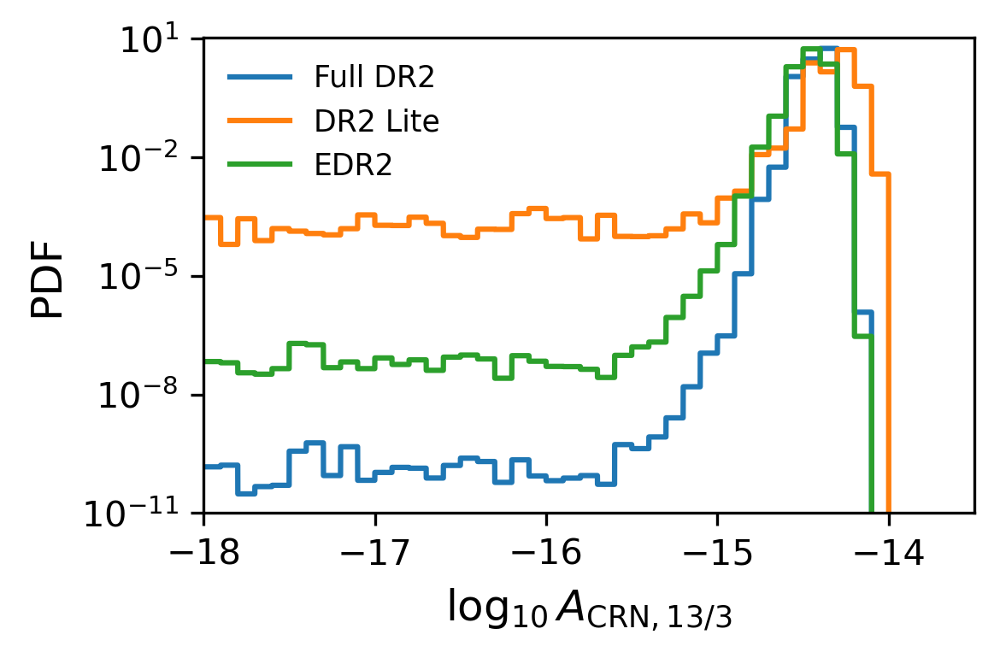

In [20]:
fig, ax = plt.subplots(figsize=(4,8/3),dpi=300)
a = np.linspace(-18,-12,10000)
# plot hists
lines = []
# compute fact like stuff
for i, lbl in enumerate(labels):
    psrnames = list(sampler_dict[lbl].keys())
    log10A_dist = FLike(sampler_dict[lbl], psrnames, bin_num=61)
    ax.plot(a,log10A_dist.pdf(a),f'-C{i}',lw=1.5,label=lbl)
    # Compute Savage-Dickey Bayes factor
    BF = (1/6)/np.mean(log10A_dist.pdf(a)[a < -16])
    print(np.log10(BF))
    # overplot CRN from PTMCMCSampler
    #ax.hist(cores[lbl]('crn_log10_A'), bins=60, density=True, histtype='stepfilled',
    #        color=f'C{i}', range=(-18,-12), alpha=0.2)#, label='Full PTA analysis')
# labels, etc
ax.set_xlabel(r'$\log_{10}A_{\rm{CRN},13/3}$', fontsize='large')
ax.set_xlim([-18,-13.5])
ylim = ax.get_ylim()
ax.set_ylabel('PDF', fontsize='large')
ax.semilogy()
ax.set_ylim([1e-11,ylim[1]+5])
ax.legend(fontsize='small', frameon=False)
#if litec and datastr == 'full':
#    title = f'IPTA DR2litec Fact Like analysis: '
#else:
#    title = f'IPTA DR2{datastr} Fact Like analysis: '
#title += fr'$\log_{{10}}\mathcal{{B}}^{{CRN+IRN}}_{{IRN}}$ = {np.log10(BF):1.2f}'
#ax.set_title(title)
fig.tight_layout()
fig.savefig(f'{figsave}/FL.png', dpi=300, bbox_inches='tight')

In [226]:
# get uncertainties of the bayes factors
for i, lbl in enumerate(labels):
    psrnames = list(sampler_dict[lbl].keys())
    log10A_dist = FLike(sampler_dict[lbl], psrnames, bin_num=61)
    ax.plot(a,log10A_dist.pdf(a),f'-C{i}',lw=1.5,label=lbl)
    # Compute Savage-Dickey Bayes factor
    log10_BF_dist = np.log10((1/6)/log10A_dist.pdf(a)[a < -16])
    log10_BF_mean = np.mean(log10_BF_dist)
    log10_BF_std = np.std(log10_BF_dist)
    print(f'{lbl}: log10_BF = {log10_BF_mean:0.1f} +- {log10_BF_std:0.1f}')

Full DR2: log10_BF = 9.1 +- 0.3
DR2 Lite: log10_BF = 3.0 +- 0.2
EDR2: log10_BF = 6.4 +- 0.2


In [83]:
figsave

'/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis/figs/dataset_comparisons/gwb'

## Compare posteriors, TM refit vs no refit - varied $\gamma$

Also compare the noise parameters

In [42]:
datasets = ['dr2lite', 'dr2lite_refit']
labels = ['DR2 Lite', 'DR2 Lite refit']
Nfreqs = [7, 7]
colors = ['C1', 'C4']
save_label = '_compare_refit'
noisetype = 'advnoise'

In [14]:
model_names = [f'CRN{Nf}_{noisetype}' for Nf in Nfreqs]
# specify pulsar, dataset, model, and number of cores
project_path = '/vast/palmer/home.grace/bbl29/IPTA_DR2_analysis'
# where to save figures
figsave = f'{project_path}/figs/dataset_comparisons/gwb'
load_pt_chains = False

In [55]:
# get cores
cores = {}
for ds, mn, lbl in zip(datasets, model_names, labels):
    corepath = f'/vast/palmer/home.grace/bbl29/project/IPTA_DR2_analysis/{ds}/{mn}/core.h5'
    cores[lbl] = co.Core(corepath=corepath)

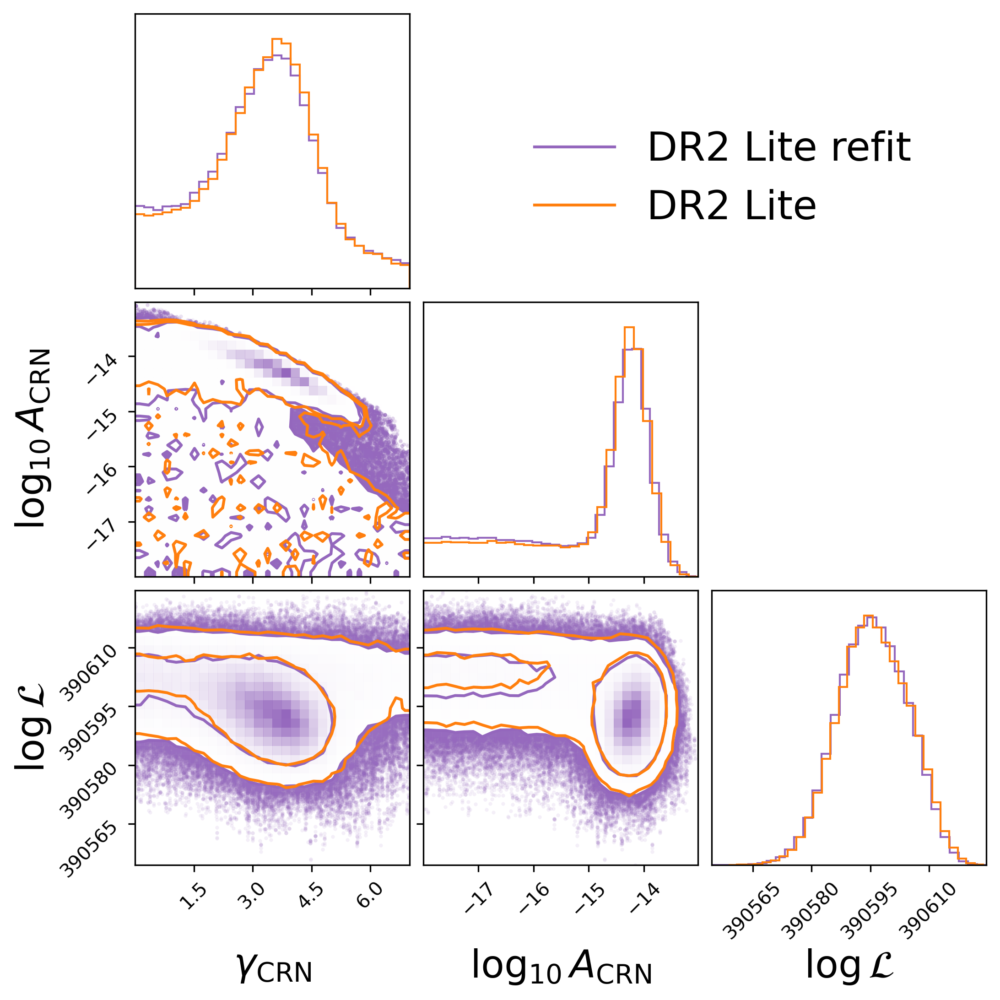

In [56]:
leg_size = 21 # 10
order = [1,0]#,1]#[1,3,2,0]#[1,2,0]
params = [p for p in cores[labels[order[-1]]].params if 'crn' in p] + ['lnlike']
param_labels = make_labels(params, None, add_psrname=False)[:-1] + [r'$\log\mathcal{L}$']
lines = []
for i in order:
    lbl = labels[i]
    p_idxs = [cores[lbl].params.index(p) for p in params]
    if i == order[0]:
        fig = corner.corner(cores[lbl].chain[:,p_idxs], levels=(0.68,0.95), labels=param_labels,
                            color=colors[i], plot_density=True, plot_datapoints=True,
                            no_fill_contours=False, hist_kwargs={'density':True},
                            label_kwargs={'fontsize':20}, bins=30, #smooth=0.5,
                            hist2d_kwargs={'contour_kwargs':{'zorder':2,'lw':0.1}})
    else:
        fig = corner.corner(cores[lbl].chain[:,p_idxs], levels=(0.68,0.95), fig=fig,
                            color=colors[i], plot_density=False, plot_datapoints=False,
                            no_fill_contours=True, hist_kwargs={'density':True},
                            bins=30, #smooth=0.5, 
                            hist2d_kwargs={'contour_kwargs':{'zorder':1,'lw':0.1}})
    lines += [mlines.Line2D([],[],color=colors[i],label=lbl)]
# add 13/3 line
#axes = np.array(fig.axes).reshape((2,2))
#axes[0,0].axvline(13/3, color='k', lw=1)
#axes[1,0].axvline(13/3, color='k', lw=1)
#axes[1,0].axhline(np.log10(2.8e-15), color='k', lw=1)
#axes[1,1].axvline(np.log10(2.8e-15), color='k', lw=1)
#lines += [mlines.Line2D([],[],color='k',lw=1,label=f'Antoniadis+2022\n'+r'$\gamma_{{\rm{{CRN}}}}=13/3$ values')]
fig.legend(handles=lines, fontsize=leg_size, frameon=False, loc='upper right', bbox_to_anchor=[0.91,0.87])
#fig.suptitle('Auto correlations only', x=0.75, y=0.59, fontsize=14) # x=0.37, y=0.97
fig.savefig(f'{figsave}/crn_corner{save_label}.png', dpi=300, bbox_inches='tight')
plt.show()

In [26]:
# values:
for lbl in cores:
    med_A = 10**cores[lbl].get_param_median("crn_log10_A")*1e15
    A_hi = 10**cores[lbl].get_param_credint("crn_log10_A", interval=95)[1]*1e15-med_A
    A_lo = med_A-10**cores[lbl].get_param_credint("crn_log10_A", interval=95)[0]*1e15
    med_gam = cores[lbl].get_param_median("crn_gamma")
    gam_hi = cores[lbl].get_param_credint("crn_gamma", interval=95)[1]-med_gam
    gam_lo = med_gam-cores[lbl].get_param_credint("crn_gamma", interval=95)[0]
    print(lbl)
    display(Math(fr'A_{{\rm{{CP}}}} = {med_A:2.1f}^{{+{A_hi:2.1f}}}_{{-{A_lo:2.1f}}}\times 10^{{-15}}'))
    display(Math(fr'\gamma_{{\rm{{CP}}}} = {med_gam:.1f}^{{+{gam_hi:.1f}}}_{{-{gam_lo:.1f}}}'))

DR2 Lite


<IPython.core.display.Math object>

<IPython.core.display.Math object>

DR2 Lite refit


<IPython.core.display.Math object>

<IPython.core.display.Math object>

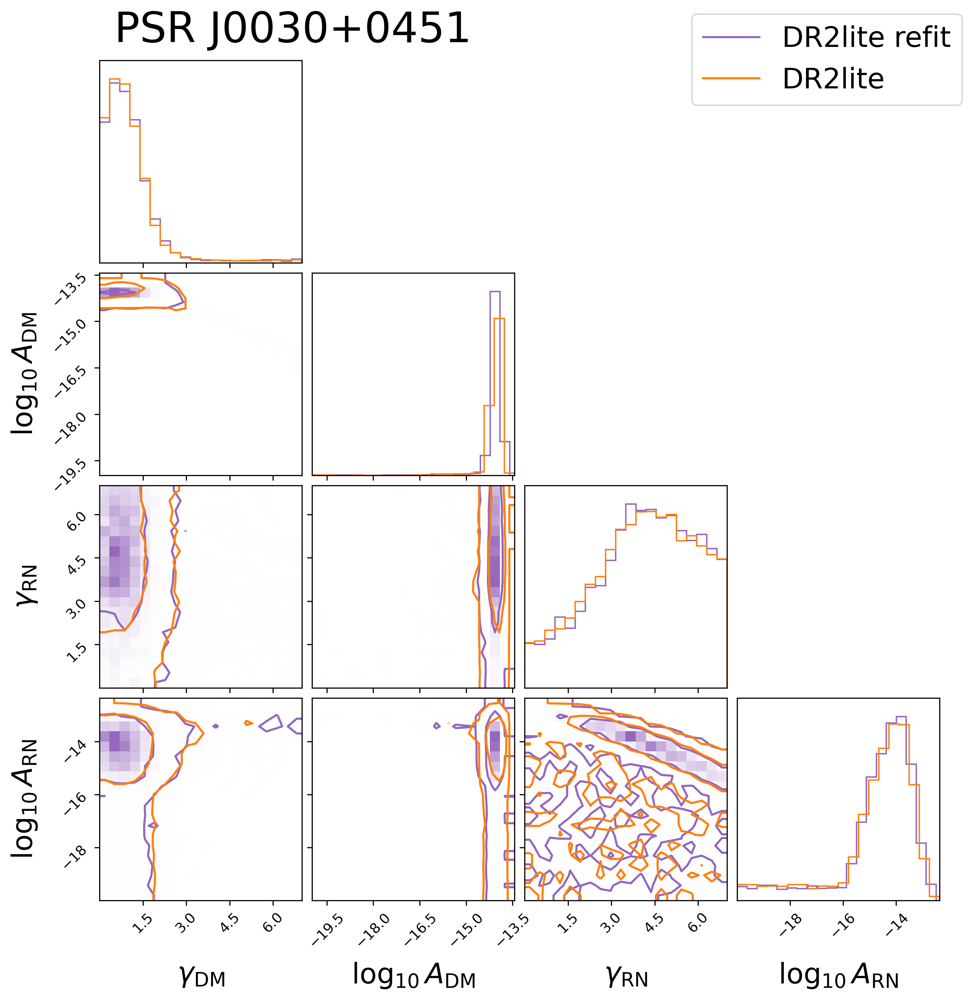

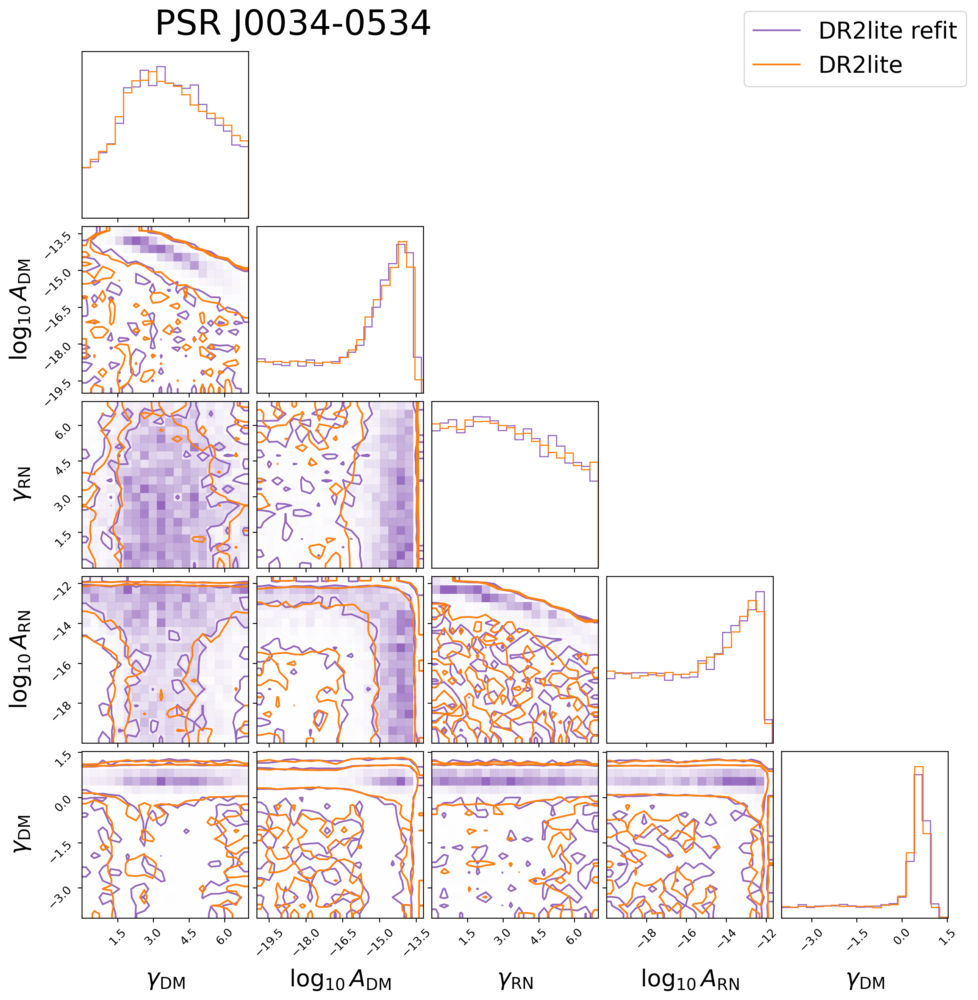

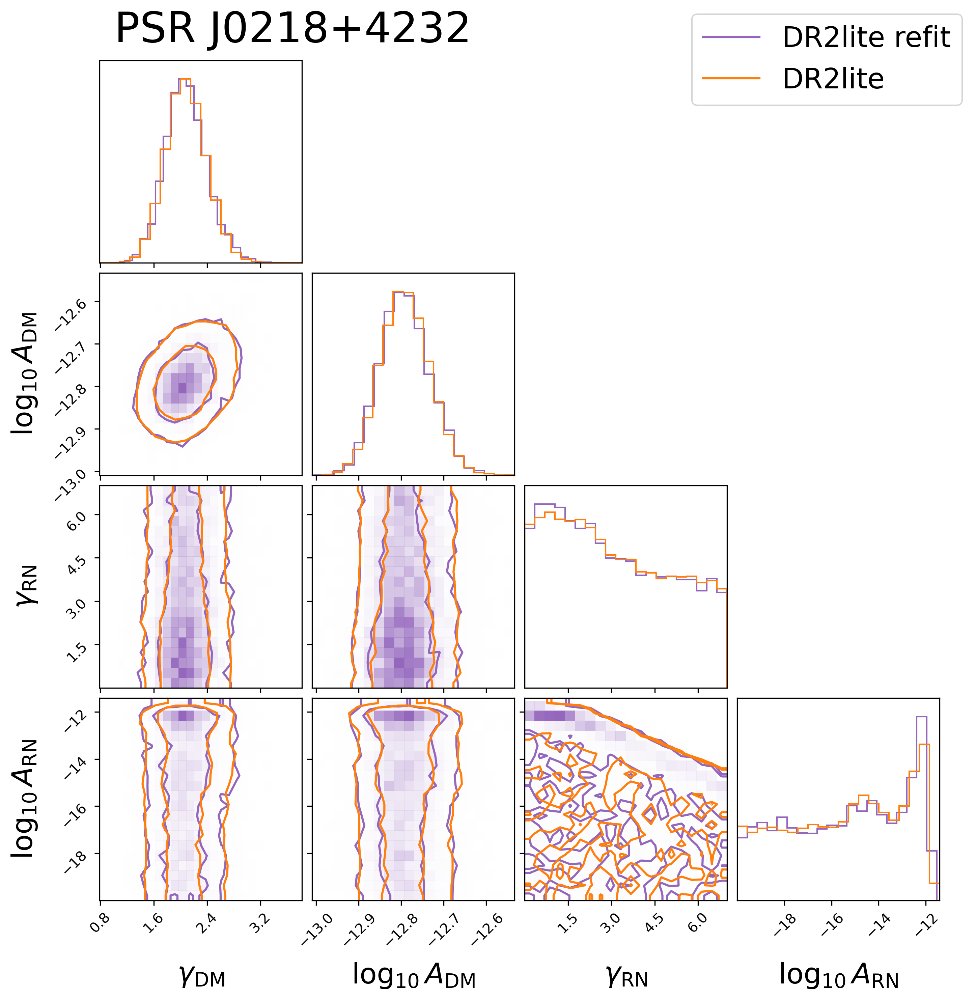

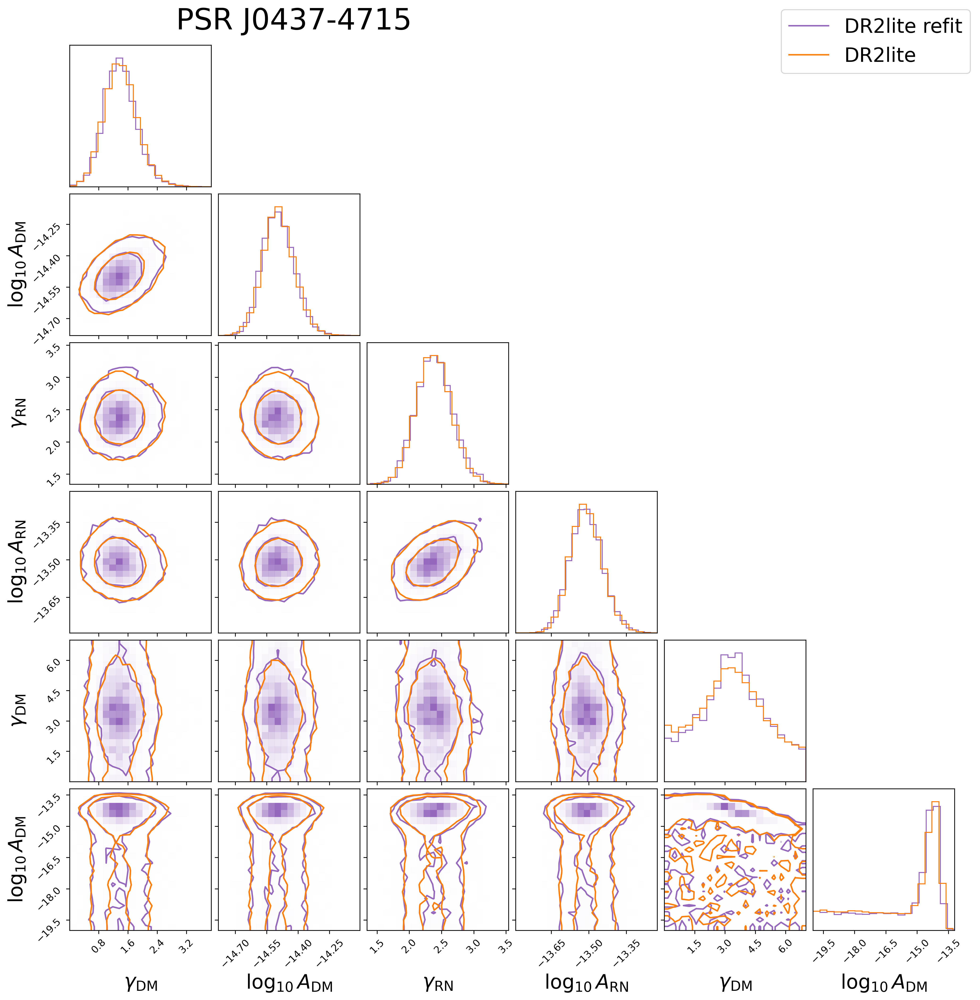

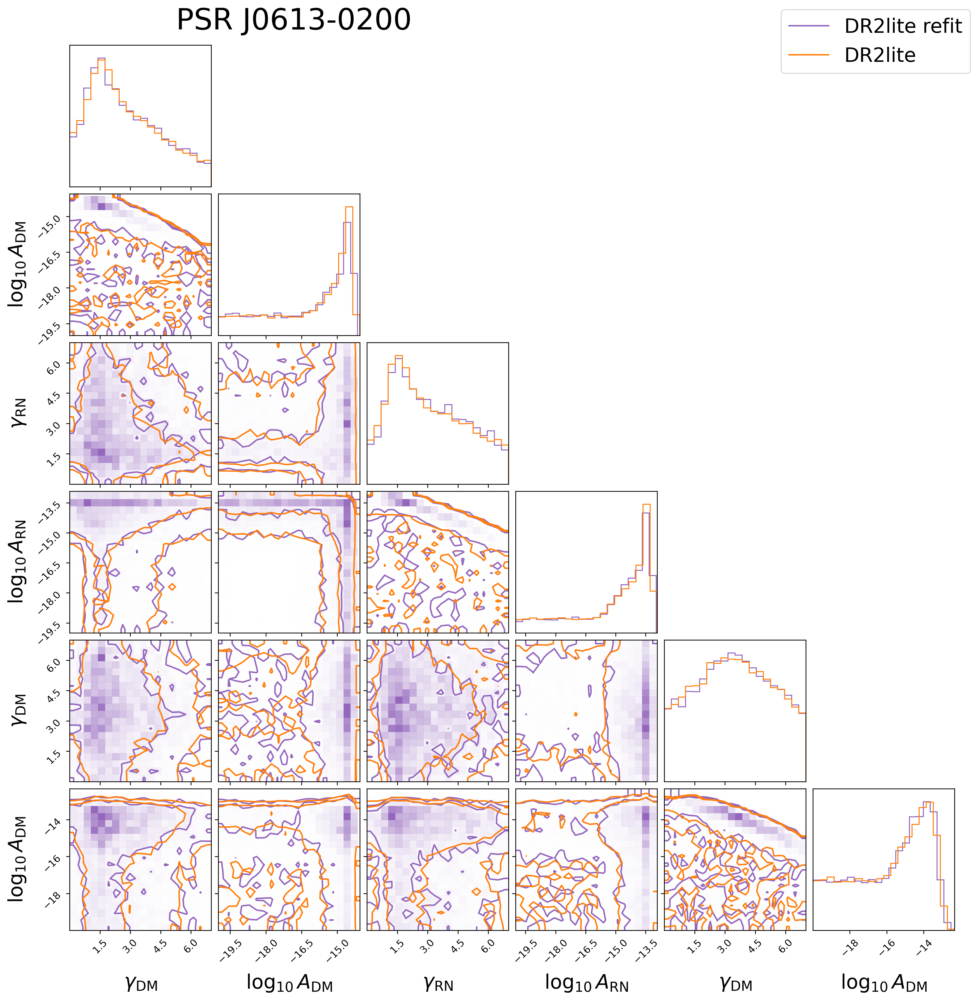

...

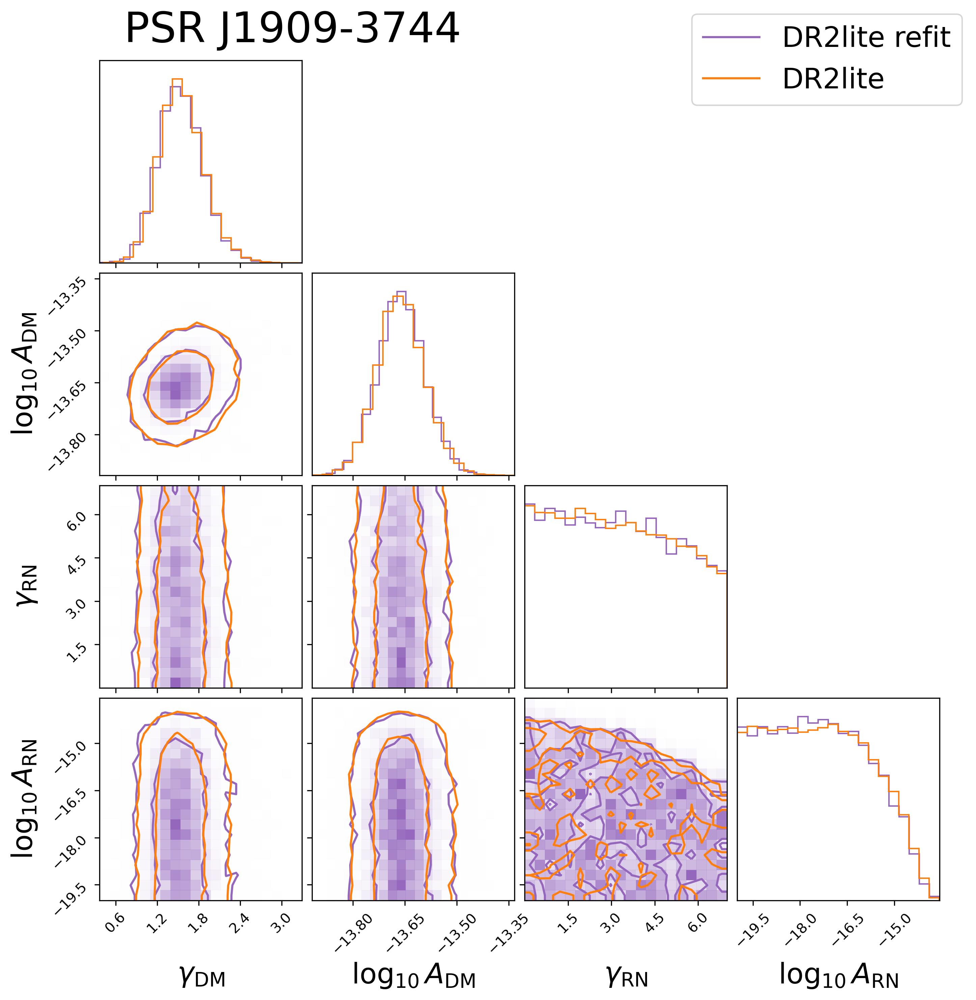

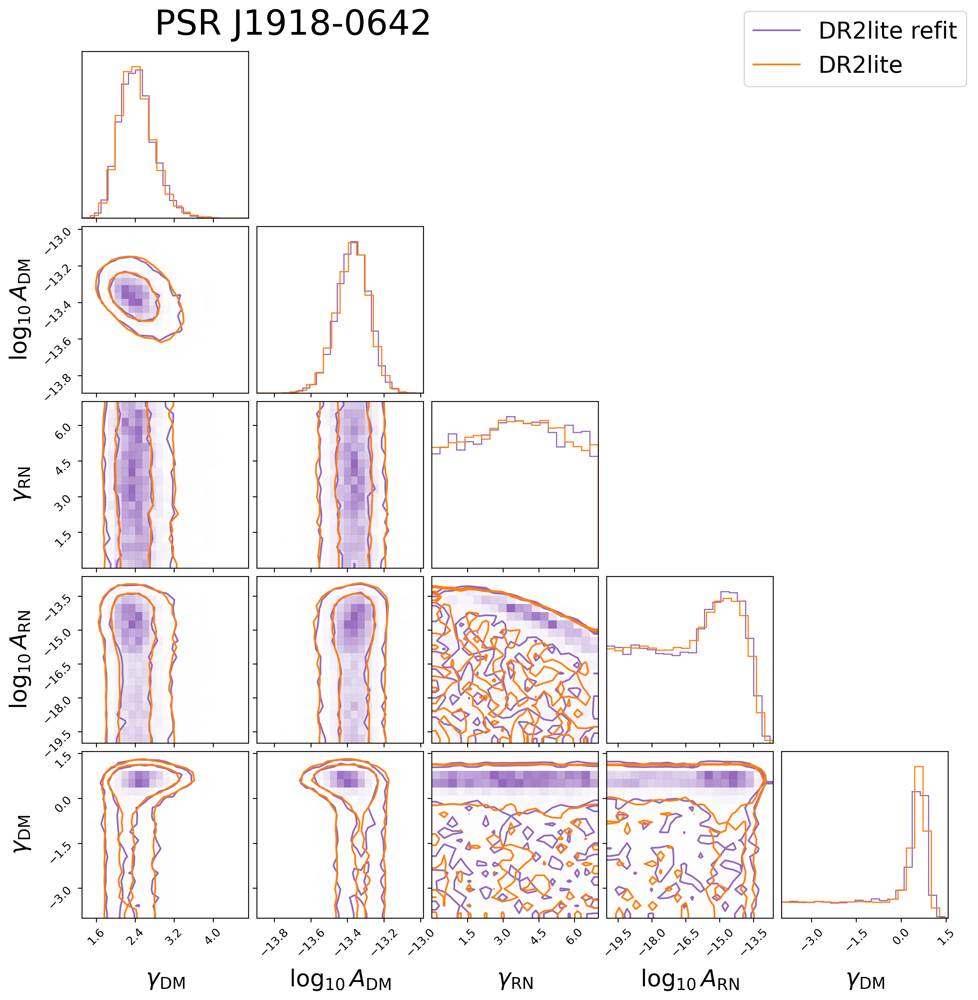

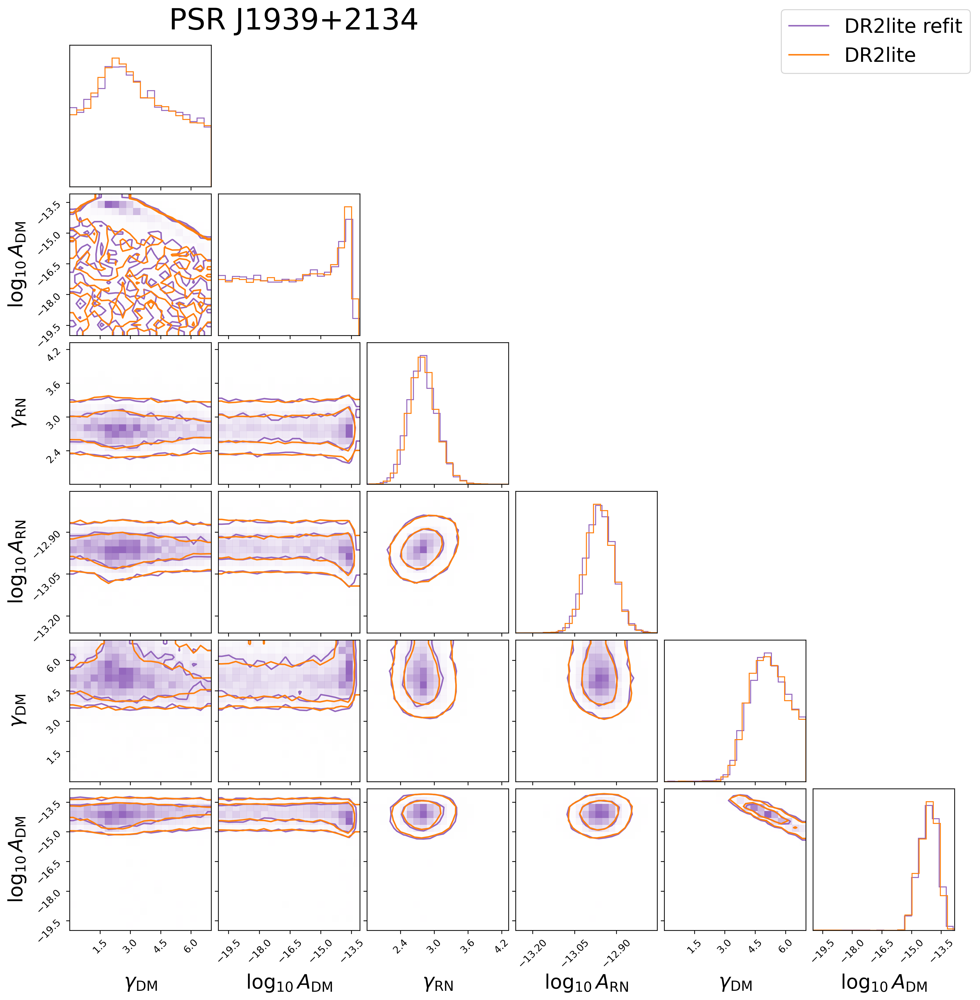

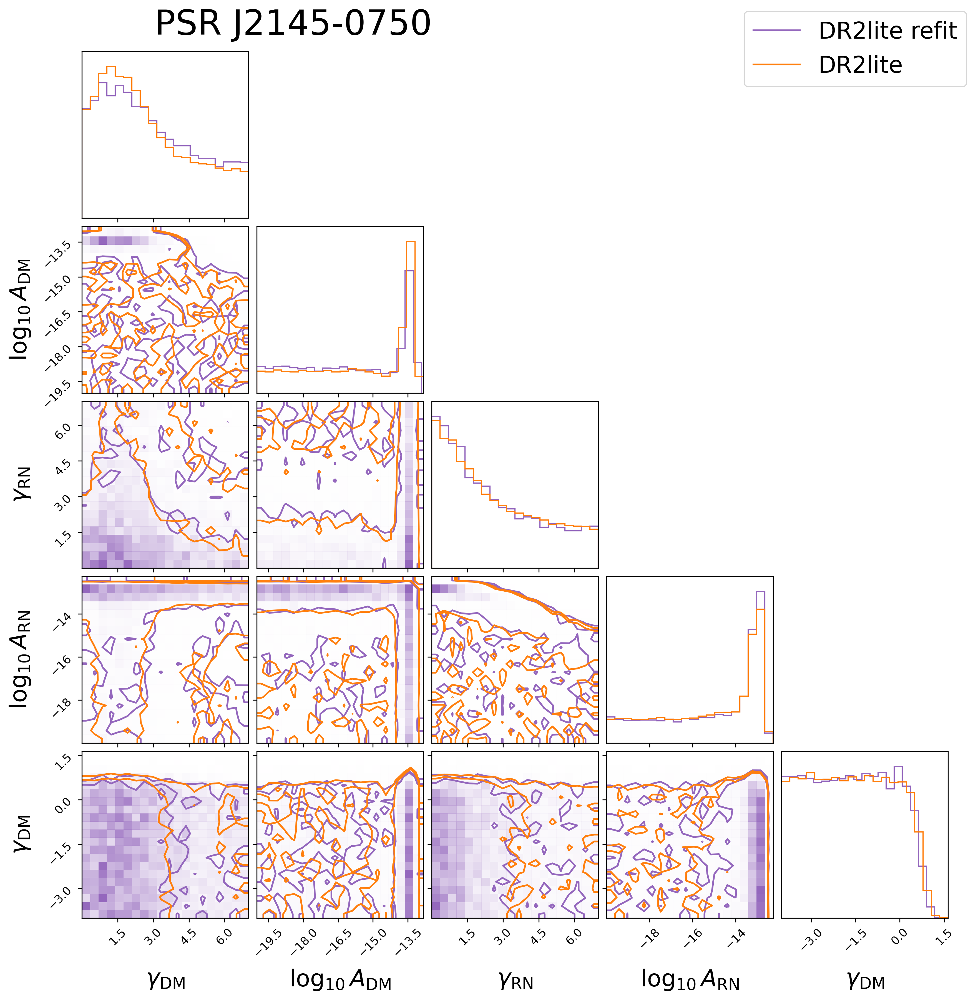

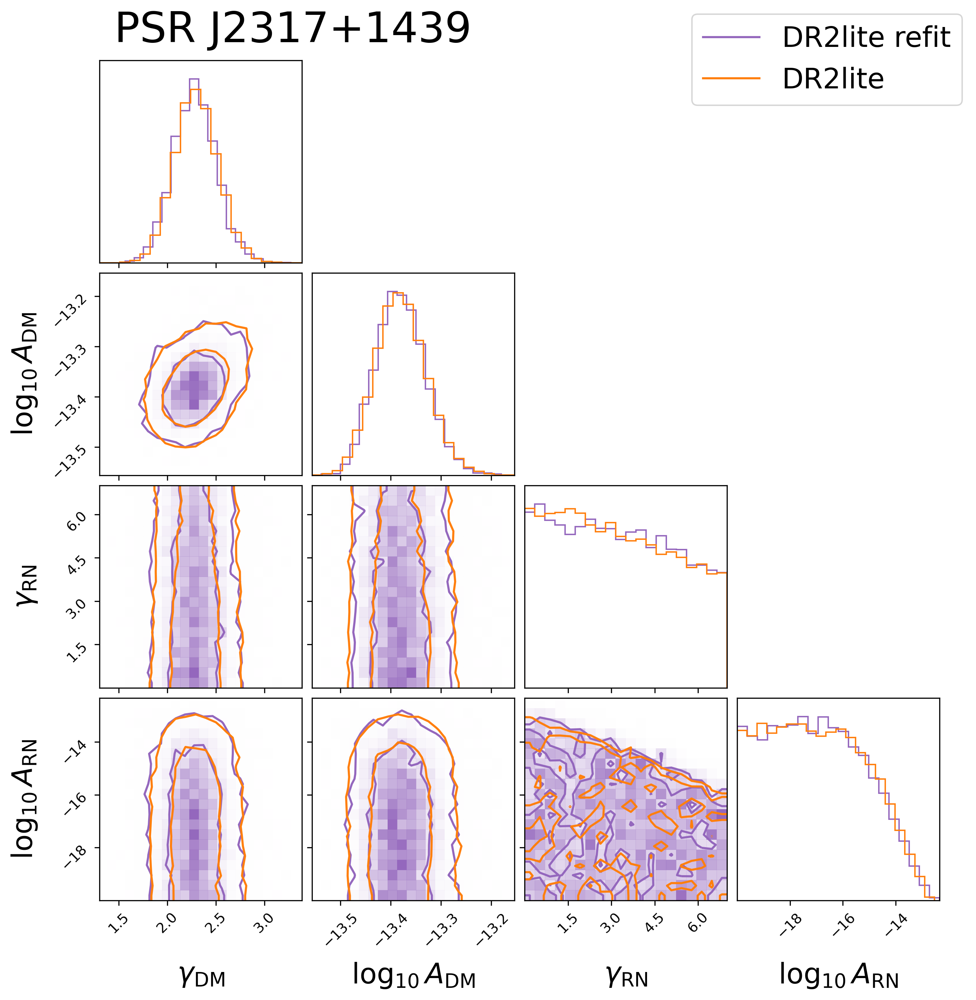

In [48]:
psrnames = np.unique([p.split('_')[0] for p in cores['DR2 Lite'].params if 'J' in p])
for psrname in psrnames:
    lbl = labels[1]
    params = [p for p in cores[lbl].params if ('gp' in p or 'red_noise' in p or 'exp' in p) and psrname in p]
    # lite refit
    p_idxs = [cores[lbl].params.index(p) for p in params]
    plabels = make_labels(params, psrname, add_psrname=False)
    fig = corner.corner(cores[lbl].chain[:,p_idxs], levels=(0.68,0.95), labels=plabels,
                        color=colors[1], plot_density=True, plot_datapoints=False,
                        no_fill_contours=True, hist_kwargs={'density':True},
                        label_kwargs={'fontsize':20})
    # lite
    lbl = labels[0]
    p_idxs = [cores[lbl].params.index(p) for p in params if psrname in p]
    fig = corner.corner(cores[lbl].chain[:,p_idxs], levels=(0.68,0.95), fig=fig,
                        color=colors[0], plot_density=False, plot_datapoints=False,
                        no_fill_contours=True, hist_kwargs={'density':True},
                        label_kwargs={'fontsize':20})
    lines = [mlines.Line2D([],[],color='C4',label=f'DR2lite refit')]
    lines += [mlines.Line2D([],[],color='C1',label=f'DR2lite')]
    fig.legend(handles=lines, fontsize=20)
    fig.suptitle(f'PSR {psrname}', fontsize=30, x=0.3, y=1.01)
    #fig.savefig(f'{figsave_dir}/{psrname}_corner.png', dpi=300, bbox_inches='tight')
    plt.show()

Text(0, 0.5, 'PDF')

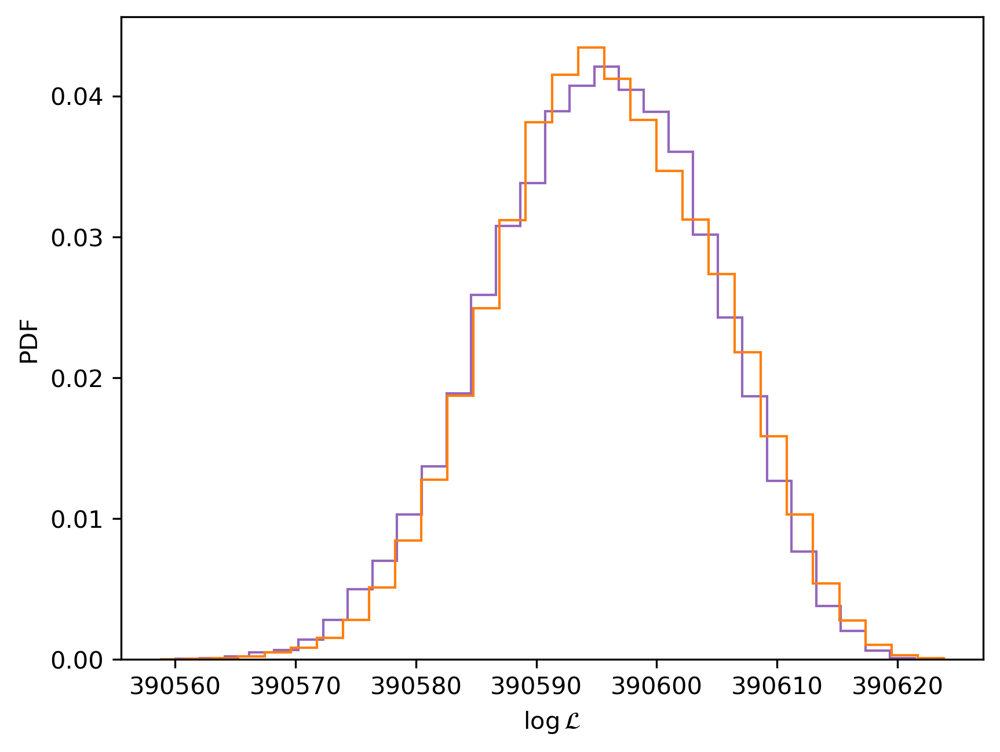

In [50]:
plt.hist(cores['DR2 Lite refit']('lnlike'), density=True, bins=30, color='C4', histtype='step')
plt.hist(cores['DR2 Lite']('lnlike'), density=True, bins=30, color='C1', histtype='step')
plt.xlabel(r'$\log\mathcal{L}$')
plt.ylabel('PDF')

In [40]:
psrnames = np.unique([p.split('_')[0] for p in cores['DR2 Lite'].params if 'J' in p])
psrname = psrnames[0]
lbl = labels[i]
[(p, cores[lbl].params.index(p)) for p in cores[lbl].params if psrname in p]

[('J0030+0451_dm_gp_gamma', 0),
 ('J0030+0451_dm_gp_log10_A', 1),
 ('J0030+0451_red_noise_gamma', 2),
 ('J0030+0451_red_noise_log10_A', 3)]

In [32]:
make_labels

<function __main__.make_labels(params, psrname, add_psrname=True)>